Team Members:\
Aryaman Gokarn(506303588)\
Mugdha Bhagwat(606297799)\
Tania Rajabally(806153219)


# **1. Facebook network**

# 1. Structural properties of the Facebook network

## QUESTION 1 :  A first look at the network:

### QUESTION 1.1

In [ ]:
#Installing the required packages
install.packages("igraph")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
library(igraph)

In [ ]:
#Path to the dataset
url <- "http://snap.stanford.edu/data/facebook_combined.txt.gz"
destfile <- "facebook_combined.txt.gz"
download.file(url, destfile, mode="wb")  # Ensure binary mode for non-text files

In [ ]:
#Load the data
graph <- read_graph(gzfile(destfile), format = "edgelist", directed = FALSE)

[1] "Number of nodes: 4039"
[1] "Number of edges: 88234"


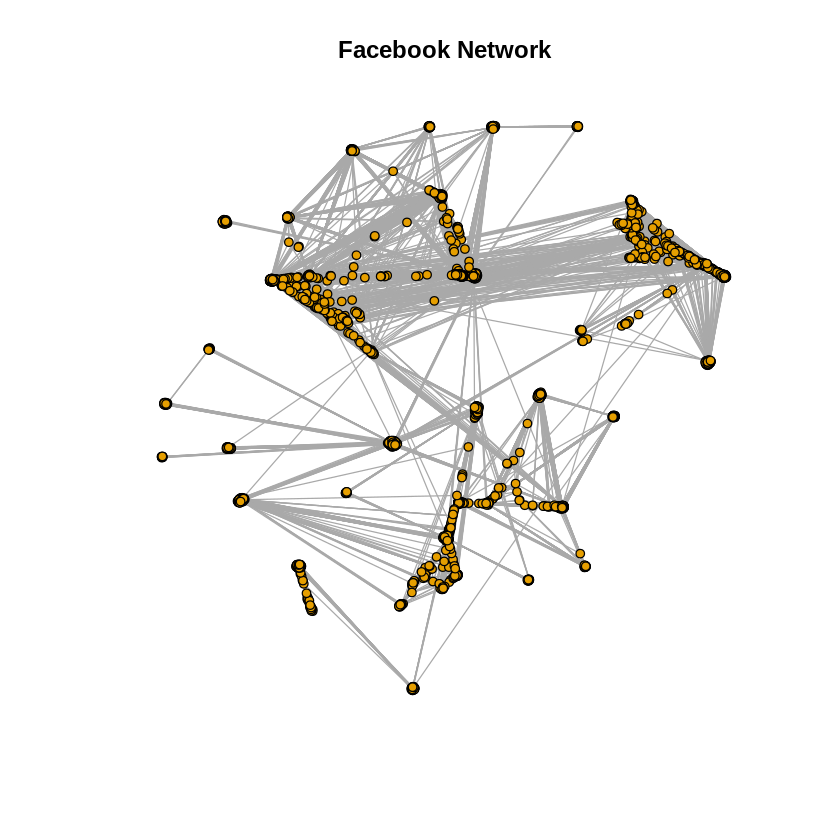

In [ ]:
#Plot the network
plot(graph,vertex.label="",vertex.size=3,main = "Facebook Network")

# Get the number of nodes
num_nodes <- vcount(graph)
# Get the number of edges
num_edges <- ecount(graph)

# Print the number of nodes and edges
print(paste("Number of nodes:", num_nodes))
print(paste("Number of edges:", num_edges))

QUESTION 1.1: Report the number of nodes and number of edges of the Facebook network.
> Refer to the network above.\
The number of nodes are: 4039\
The number of edges are: 88234

### QUESTION 1.2

In [ ]:
#To check if the network is connected
is_connected <- is_connected(graph)
print(paste("Is the Facebook network connected?", is_connected))

[1] "Is the Facebook network connected? TRUE"


In [ ]:
if (!is_connected) {
  # Finding all components
  components <- components(graph)
  # Identifying the giant component
  gcc_index <- which.max(components$csize)
  gcc <- induced_subgraph(graph, which(components$membership == gcc_index))

  # Report the size of the GCC
  gcc_size <- vcount(gcc)
  print(paste("Size of the Giant Connected Component (nodes):", gcc_size))
}

QUESTION 1.2: Is the Facebook network connected? If not, find the giant connected component (GCC) of the network and report the size of the GCC.

> The Facebook network is connected. This means that there are no isolated users (nodes) without any friends in the network and all users have some connection (edges) with other users. Since this graph is connected, we do not find the GCC. But, the code above will first check if the network is connected. If not, it calculates all connected components, identifies the largest one (i.e., the GCC), and then extracts this subgraph to determine its size. The size of the GCC is given in terms of the number of vertices it contains.

## QUESTION 2

In [ ]:
if (is_connected) {
  # Calculate the diameter of the entire network
  network_diameter <- diameter(graph, directed = FALSE)
  print(paste("Diameter of the network:", network_diameter))
} else {
  # Calculate the diameter of the Giant Connected Component (GCC)
  components <- components(graph)
  gcc_index <- which.max(components$csize)
  gcc <- induced_subgraph(graph, which(components$membership == gcc_index))

  # Calculate and print the diameter of the GCC
  gcc_diameter <- diameter(gcc, directed = FALSE)
  print(paste("Diameter of the Giant Connected Component:", gcc_diameter))
}

[1] "Diameter of the network: 8"


QUESTION 2: Find the diameter of the network. If the network is not connected, then find the diameter of the GCC.

> The diameter of the network is 8.\
The diameter function finds the longest of all the shortest paths between any pair of vertices in the graph. It gives you the diameter based on unweighted paths. Since the network is connected, we find the diameter of the network.


## QUESTION 3

In [ ]:
# Get degree of each vertex
degree_data <- degree(graph)

# Calculate average degree
average_degree <- mean(degree_data)
print(paste("Average degree:", average_degree))

[1] "Average degree: 43.6910126268878"


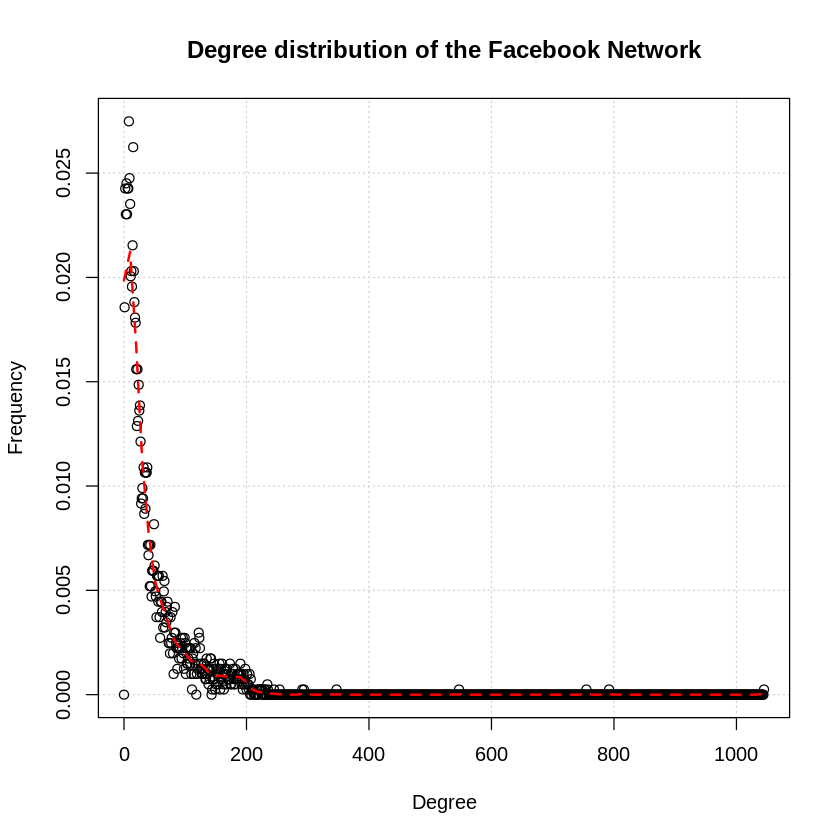

In [ ]:
#Plotting the degree distribution
plot(seq_along(degree_distribution(graph)) - 1, degree_distribution(graph),
         main="Degree distribution of the Facebook Network",xlab="Degree",ylab="Frequency",grid())
lines(lowess(seq_along(degree_distribution(graph)) - 1,degree_distribution(graph),f = 0.027), col="red",lwd = 2,lty=2)

QUESTION 3: Plot the degree distribution of the facebook network and report the average degree.

> Please refer to the degree distribution above.\
The average degree is 43.6910126268878\
The function degree(graph) retrieves the number of connections for each node in the network. The average degree is calculated as the mean of the degree data.

## QUESTION 4

[1] "Estimated slope of the line: -1.18016441925088"


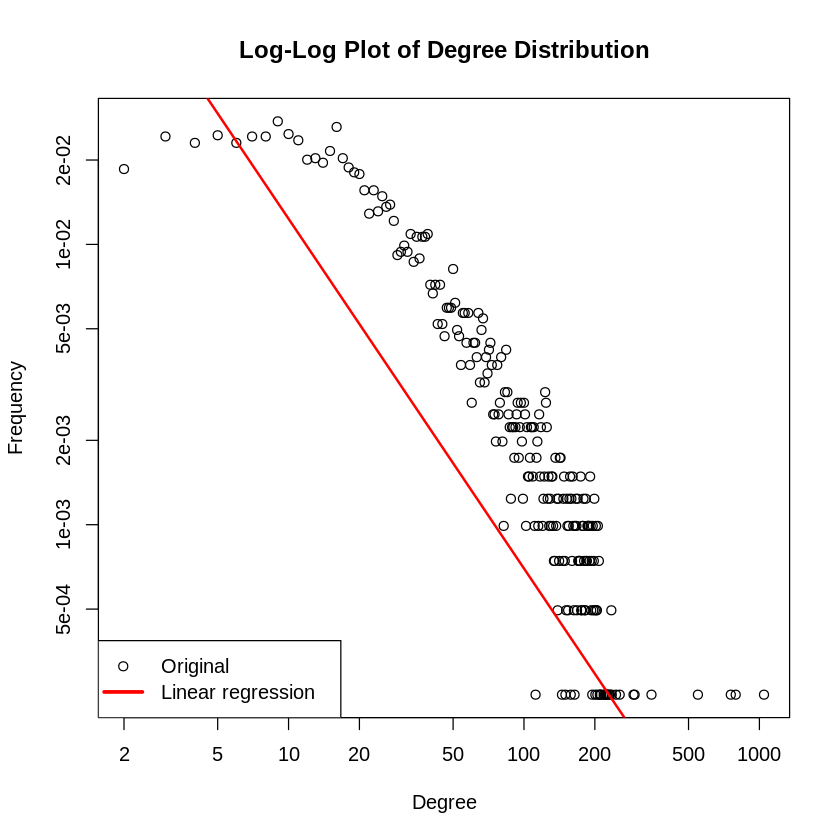

In [ ]:
# Compute the degree distribution
deg_dist = degree.distribution(graph)
degrees <- c(1:length(deg_dist))[which(deg_dist !=0, arr.ind = TRUE)]
distribution <-deg_dist[which(deg_dist !=0, arr.ind = TRUE)]

# Plot the degree distribution in log-log scale
plot(degrees, distribution, log = "xy", type = "p",
     xlab = "Degree", ylab = "Frequency",col="black", main = "Log-Log Plot of Degree Distribution")

# Fit a line to the log-log plot
abline(lm(log(distribution) ~ log(degrees)),col="red",lwd=2)

legend('bottomleft', legend = c("Original", "Linear regression"),
       lty = c(0, 1), lwd = c(1,3), pch=c(1,NA),
       col = c('black','red'))

# Extract the slope of the fitted line
slope <- coef(fit)[2]
print(paste("Estimated slope of the line:", slope))

QUESTION 4: Plot the degree distribution of Question 3 in a log-log scale. Try to fit a line to the plot and estimate the slope of the line.

> Refer to the plot above.\
The estimated slope of the line is  -1.18016441925088.\
We see that the degree-distribution in the log-log scale is approximately linear. In preferential attachment models, nodes with higher degrees or connectedness are more likely to receive edges with newer nodes without any heuristics on whether an incoming node is related to a high-degree node or not. This results in a sparse network with a large number of high-degree nodes. However, for social networks, users tend to form communities with known (mutual) friends, leading to densely packed communities of known users with heterogeneous connectedness.

# 2. Personalized network

## QUESTION 5

[1] "Number of nodes in the personalized network: 348"
[1] "Number of edges in the personalized network: 2866"


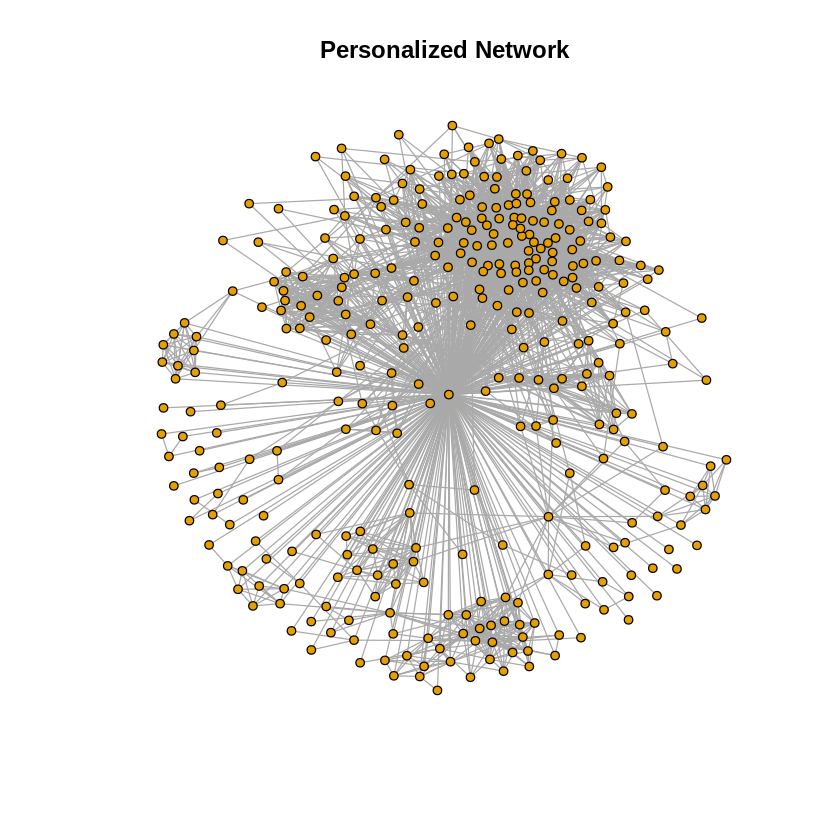

In [ ]:
# Create the personalized network for user ID 1
personalized_network <- make_ego_graph(graph, order = 1, nodes = V(graph), mindist = 0)[[1]]

plot(personalized_network,vertex.label="",vertex.size=3,main = "Personalized Network")

# Count the number of nodes and edges in the personalized network
num_nodes <- vcount(personalized_network)
num_edges <- ecount(personalized_network)

# Print the number of nodes and edges
print(paste("Number of nodes in the personalized network:", num_nodes))
print(paste("Number of edges in the personalized network:", num_edges))

QUESTION 5: Create a personalized network of the user whose ID is 1. How many nodes and edges does this personalized network have? Hint Useful function(s): makeegograph

> Refer to the personalized graph above.\
The Number of nodes in the personalized network is 348.\
The Number of edges in the personalized network: 2866.

## QUESTION 6

In [ ]:
# Calculate the diameter of the personalized network
diameter_personalized_network <- diameter(personalized_network, directed = FALSE)

# Print the diameter of the personalized network
print(paste("Diameter of the personalized network:", diameter_personalized_network))

[1] "Diameter of the personalized network: 2"


QUESTION 6: What is the diameter of the personalized network? Please state a trivial upper
and lower bound for the diameter of the personalized network.

> The diameter of the personalized network is 2.\
The trivial upper bound for diameter is 2.\
The trivial lower bound for diameter is 1.\
Trivial upper bound for diameter: It is one less than the number of nodes in the network because in the worst-case scenario, the diameter occurs when the graph is a linear chain.\
Trivial lower bound for diameter: If the personalized network contains only one node, its diameter is trivially 0. Otherwise, it's 1, as there must be at least one edge between two nodes for them to be connected.

## QUESTION 7

QUESTION 7: In the context of the personalized network, what is the meaning of the diameter of the personalized network to be equal to the upper bound you derived in Question 6. What is the meaning of the diameter of the personalized network to be equal to the lower bound you derived in Question 6 (assuming there are more than 3 nodes in the personalized network)?

> The diameter of a graph is defined as the largest distance between any pair of nodes (greatest shortest path between any two nodes). If the diameter of a personalized network is 2, it means that there exists users who are
not connected directly in the subgraph, but are connected through a mutual user. On the other hand, if the diameter of a personalized network is 1, then all users in the network know each other directly and there exists direct edges between all vertices in the network. The network in this case is fully
connected. If the diameter of the personalized network equals the upper bound (N-1, where N is the number of nodes in the network), it indicates a linear or path like structure. The network forms a path where each node is connected sequentially to the next, and there are no shortcuts or additional connections that decrease the maximum distance between any two nodes. In this configuration, each node (except for those at the ends) has exactly two neighbors, and the end nodes have only one neighbor. This implies that communication or interaction within the network must pass through multiple intermediaries, potentially reducing efficiency and increasing the steps required to reach from one end of the network to the other.\
If the diameter of the personalized network is equal to the lower bound it indicates a complete graph or clique. Every node is directly connected to every other node in the network. This configuration indicates a highly interconnected network where information or influence can spread quickly and efficiently. Each node has direct and immediate access to all other nodes, facilitating rapid communication and potentially leading to a robust network where nodes can quickly mobilize or respond to changes.

# 3. Core node’s personalized network

## QUESTION 8

In [ ]:
#Finding the core nodes
coreNodes <- which(neighborhood.size(graph,1,nodes=V(graph))>201)
print(paste("Number of core nodes in the Facebook network:",length(coreNodes)))
#Finding the degree of the core nodes
degCoreNodes <- mean(degree(graph, v=V(graph)[coreNodes]))1
print(paste("Average degree of the core nodes:",degCoreNodes))

Warning message:
“`neighborhood.size()` was deprecated in igraph 2.0.0.
Please use `ego_size()` instead.”


[1] "Number of core nodes in the Facebook network: 40"
[1] "Average degree of the core nodes: 279.375"


QUESTION 8: How many core nodes are there in the Facebook network. What is the average degree of the core nodes?

> The number of core nodes in the Facebook network is 40.\
The average degree of the core nodes is 279.375.

## QUESTION 9

In [ ]:
#Node IDs given in the question
node_list <- c(1,108,349,484,1087)
eg <- make_ego_graph(graph, order = 1, nodes = V(graph)[node_list])

[1] "Modularity using Fast Greedy for Node ID 1: 0.413101"
[1] "Modularity using Edge-Betweenness for Node ID 1: 0.353302"
[1] "Modularity using Infomap for Node ID: 1: 0.389118"


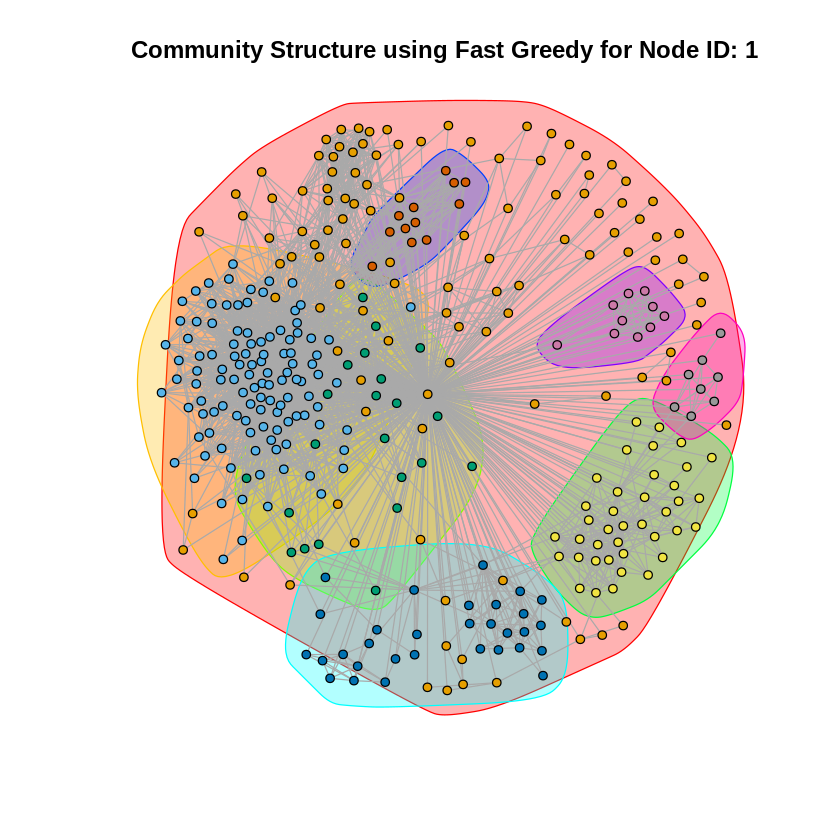

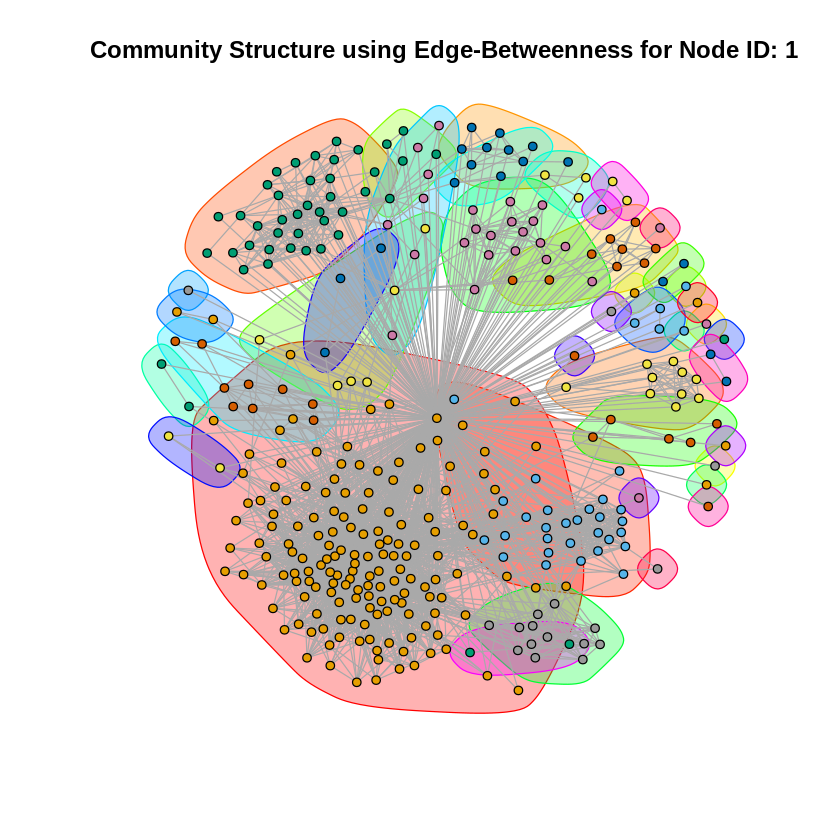

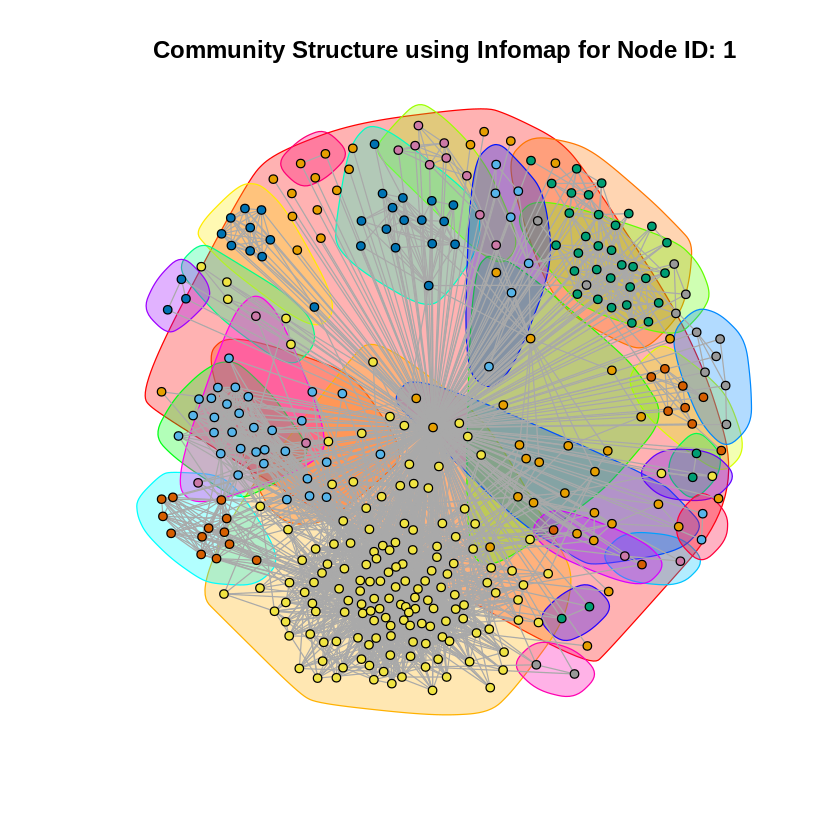

In [ ]:
#For Node ID 1
node <- 1

# Create the personalized network for the core node
personalized_network <- eg[[node]]

# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(personalized_network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(personalized_network)
eb_modularity <- modularity(eb_clusters)

# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(personalized_network)
infomap_modularity <- modularity(infomap_clusters)

print(sprintf("Modularity using Fast Greedy for Node ID %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID: %d: %f",node_list[node], infomap_modularity))

#Plotting
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,vertex.color=eb_clusters$membership,vertex.label="",main = sprintf("Community Structure using Edge-Betweenness for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure using Infomap for Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID 108: 0.435929"
[1] "Modularity using Edge-Betweenness for Node ID 108: 0.506755"
[1] "Modularity using Infomap for Node ID: 108: 0.508223"


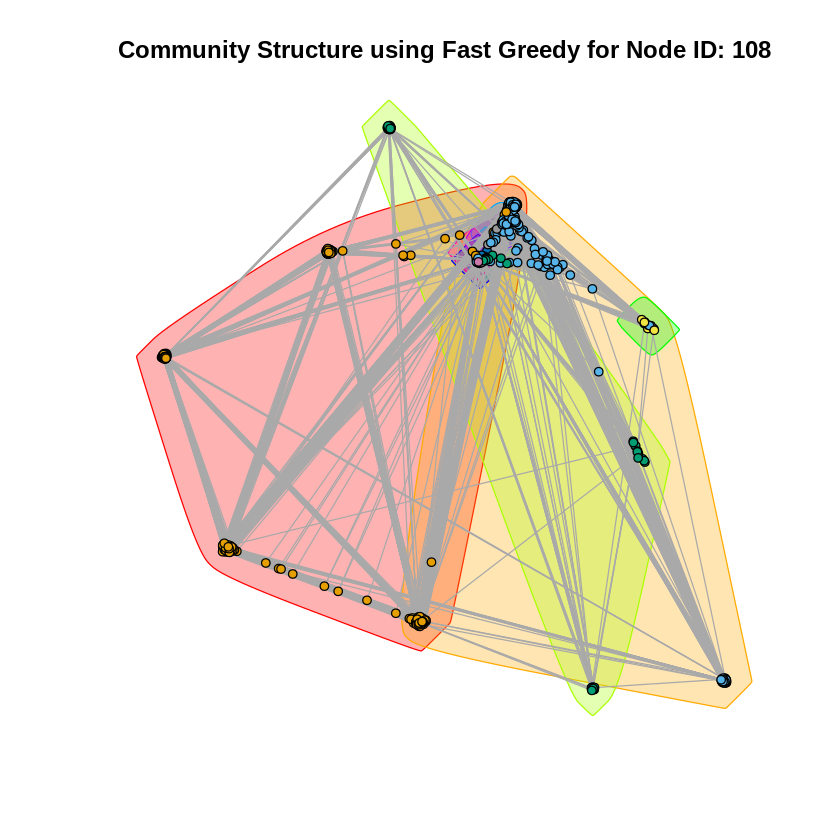

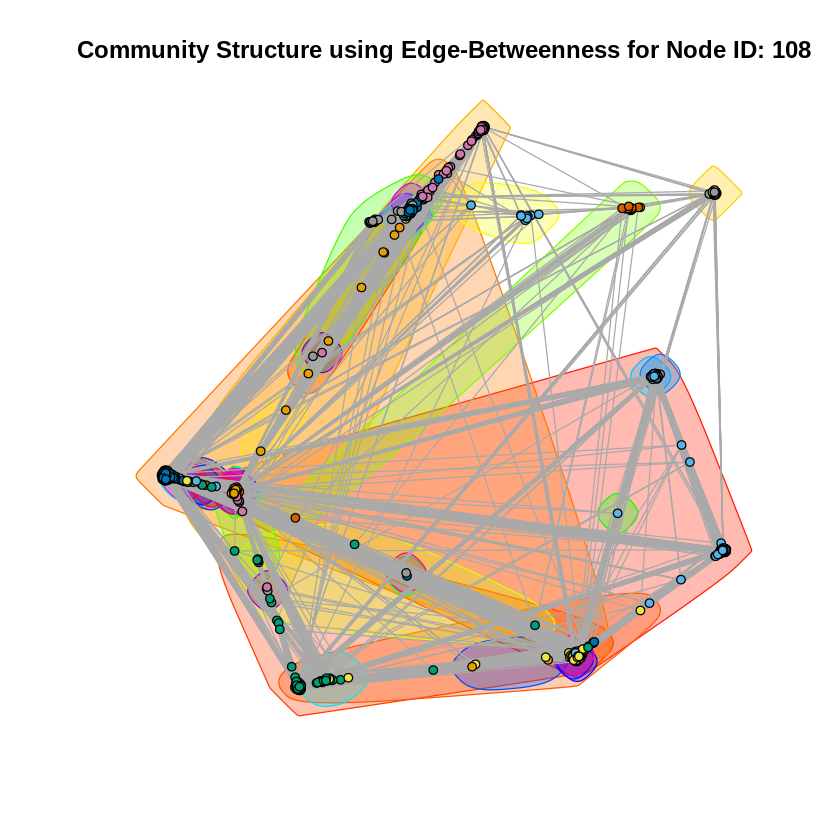

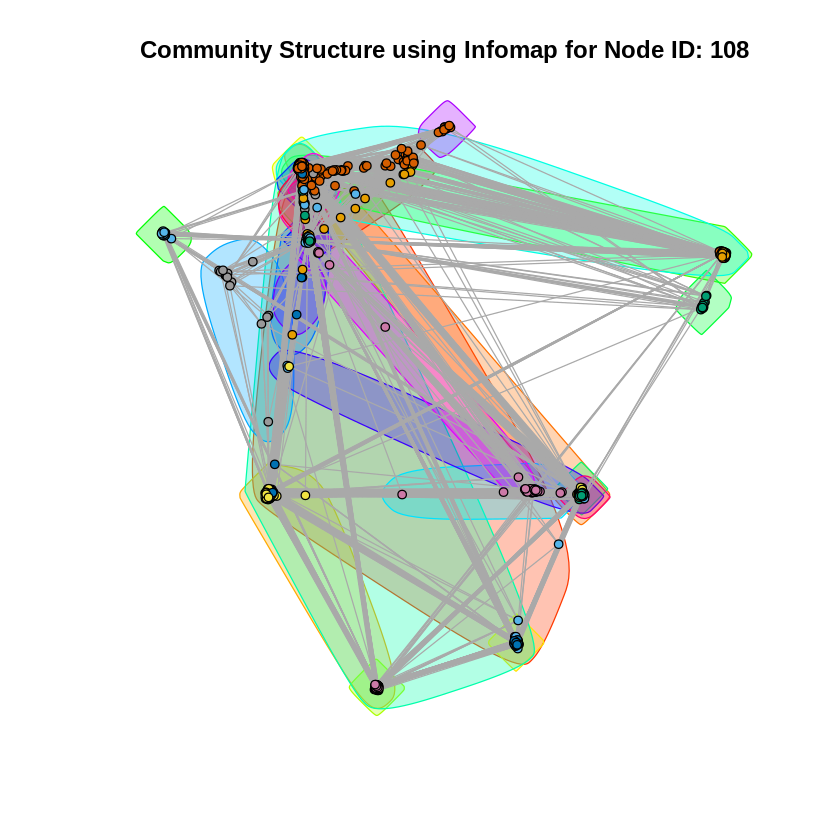

In [ ]:
#For Node ID 108
node <- 2

# Create the personalized network for the core node
personalized_network <- eg[[node]]

# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(personalized_network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(personalized_network)
eb_modularity <- modularity(eb_clusters)

# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(personalized_network)
infomap_modularity <- modularity(infomap_clusters)

print(sprintf("Modularity using Fast Greedy for Node ID %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID: %d: %f",node_list[node], infomap_modularity))

#Plotting
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,vertex.color=eb_clusters$membership,vertex.label="",main = sprintf("Community Structure using Edge-Betweenness for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure using Infomap for Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID 349: 0.251715"
[1] "Modularity using Edge-Betweenness for Node ID 349: 0.133528"
[1] "Modularity using Infomap for Node ID: 349: 0.095464"


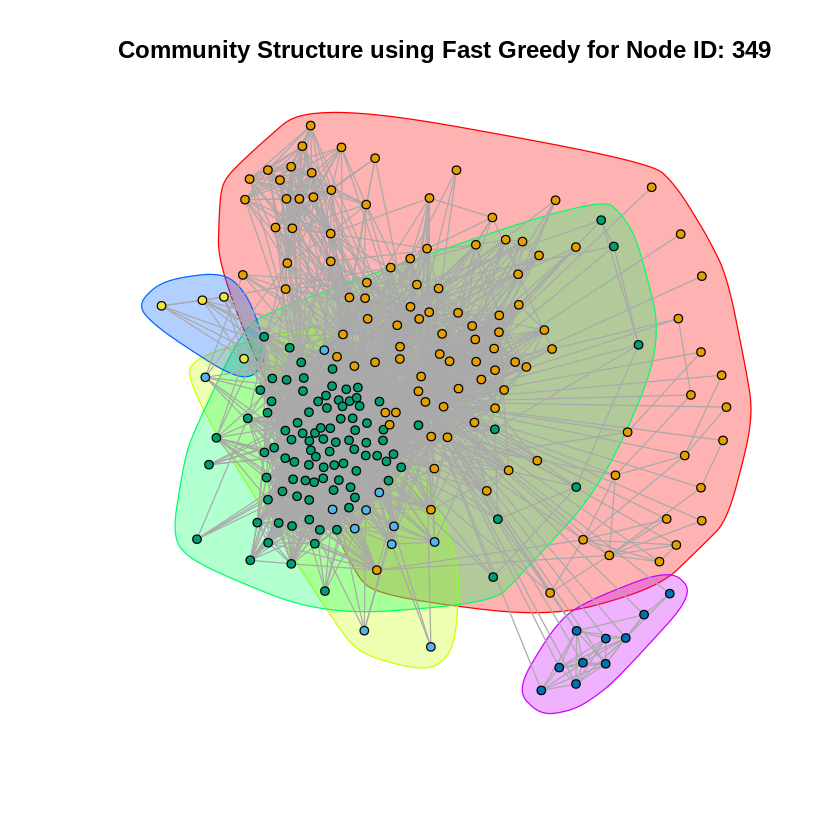

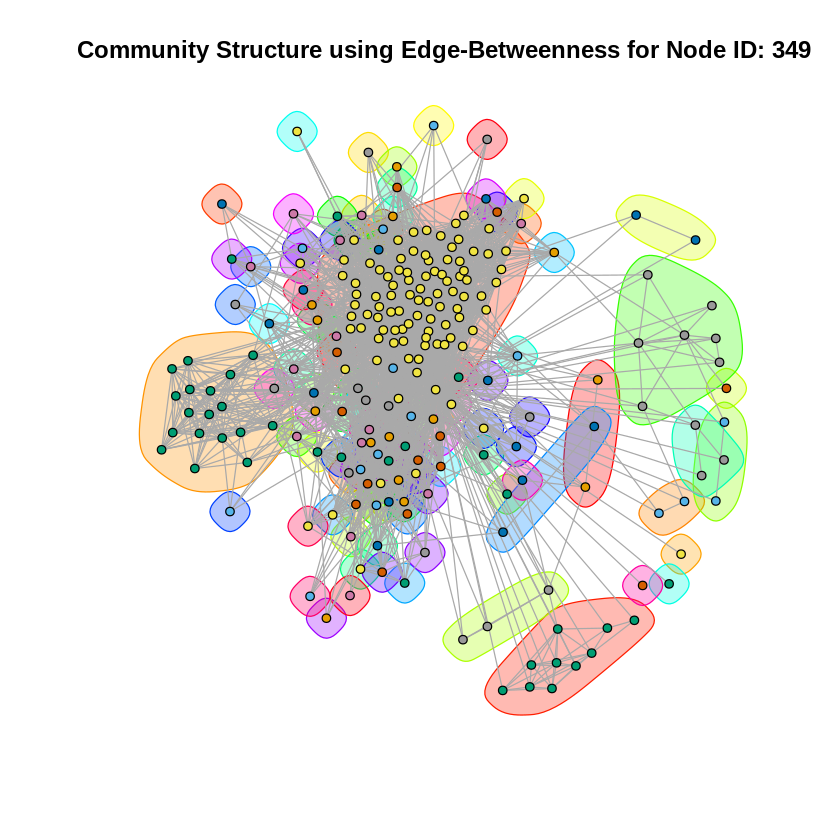

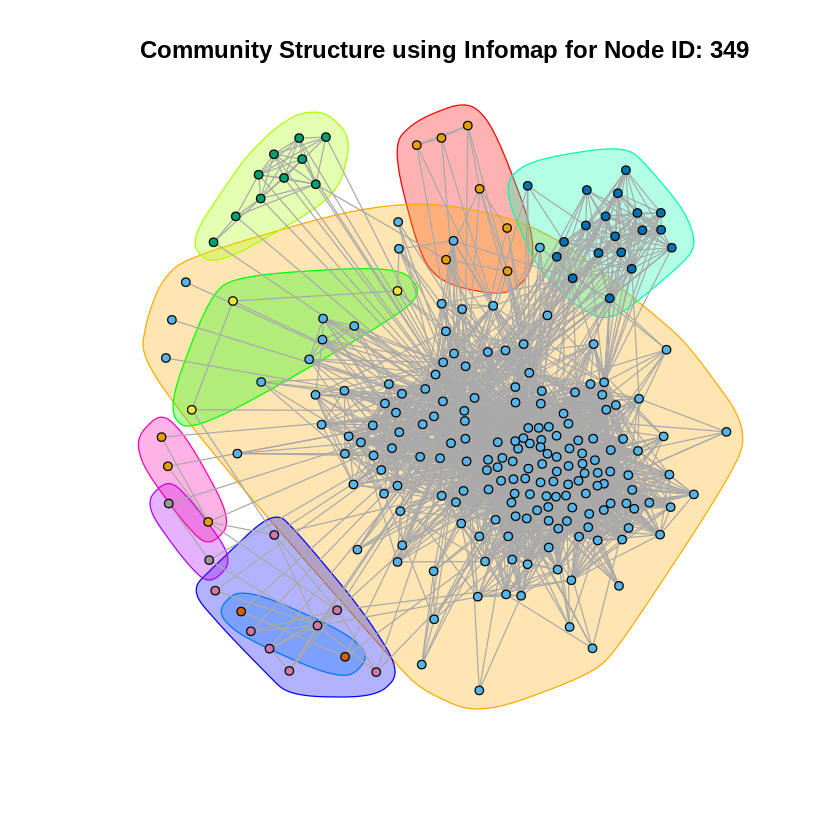

In [ ]:
#For Node ID 349
node <- 3

# Create the personalized network for the core node
personalized_network <- eg[[node]]

# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(personalized_network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(personalized_network)
eb_modularity <- modularity(eb_clusters)

# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(personalized_network)
infomap_modularity <- modularity(infomap_clusters)

print(sprintf("Modularity using Fast Greedy for Node ID %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID: %d: %f",node_list[node], infomap_modularity))

#Plotting
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,vertex.color=eb_clusters$membership,vertex.label="",main = sprintf("Community Structure using Edge-Betweenness for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure using Infomap for Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID 484: 0.507002"
[1] "Modularity using Edge-Betweenness for Node ID 484: 0.489095"
[1] "Modularity using Infomap for Node ID: 484: 0.515279"


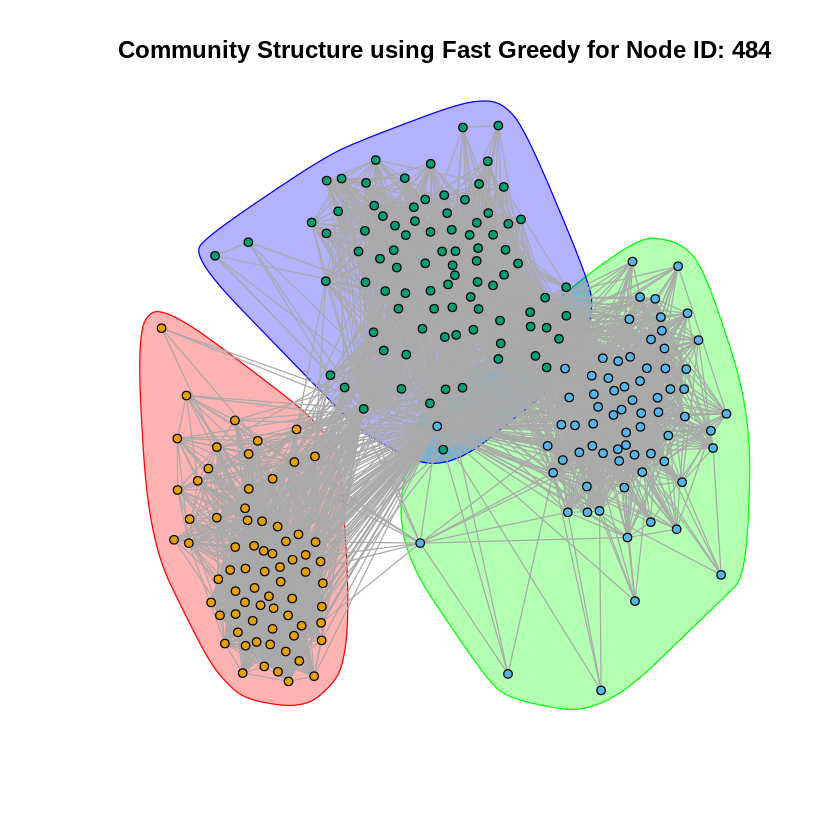

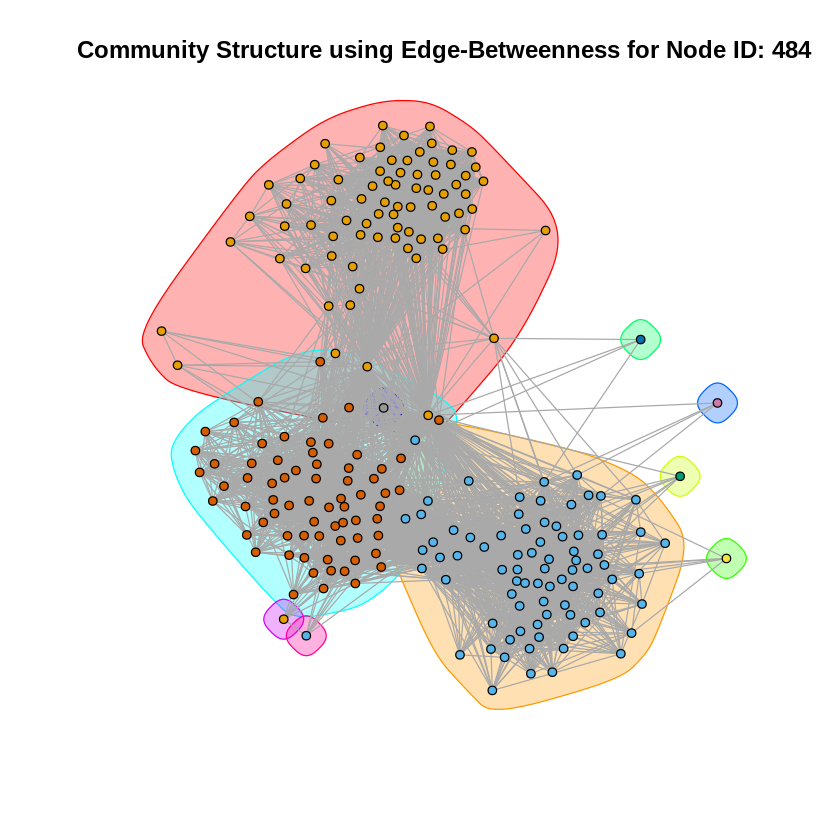

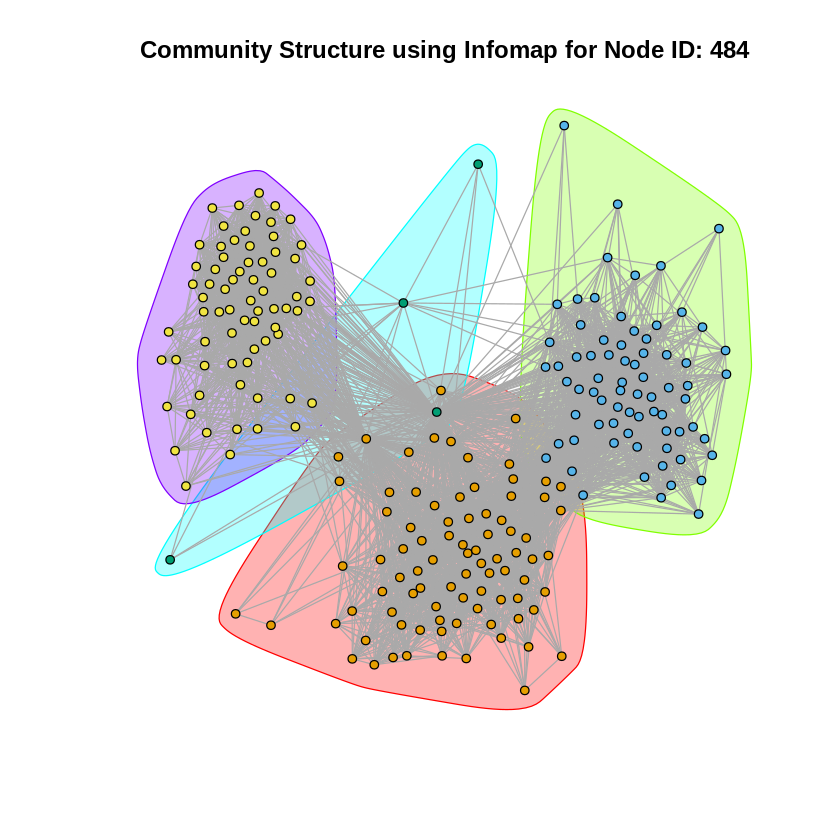

In [ ]:
#For Node ID 484
node <- 4

# Create the personalized network for the core node
personalized_network <- eg[[node]]

# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(personalized_network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(personalized_network)
eb_modularity <- modularity(eb_clusters)

# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(personalized_network)
infomap_modularity <- modularity(infomap_clusters)

print(sprintf("Modularity using Fast Greedy for Node ID %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID: %d: %f",node_list[node], infomap_modularity))

#Plotting
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,vertex.color=eb_clusters$membership,vertex.label="",main = sprintf("Community Structure using Edge-Betweenness for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure using Infomap for Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID 1087: 0.145531"
[1] "Modularity using Edge-Betweenness for Node ID 1087: 0.027624"
[1] "Modularity using Infomap for Node ID: 1087: 0.026907"


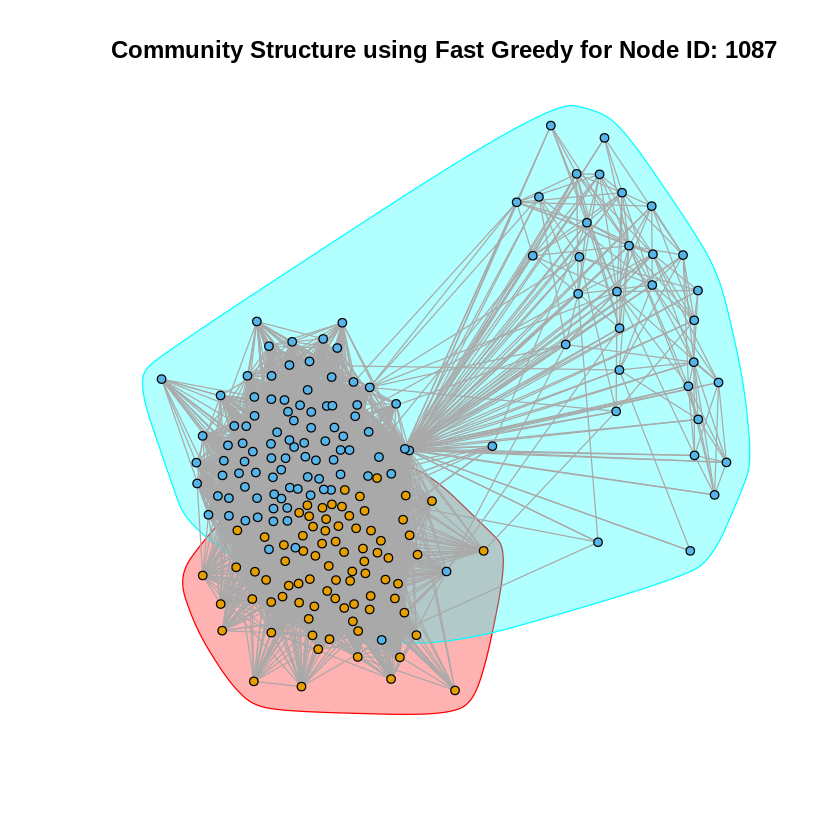

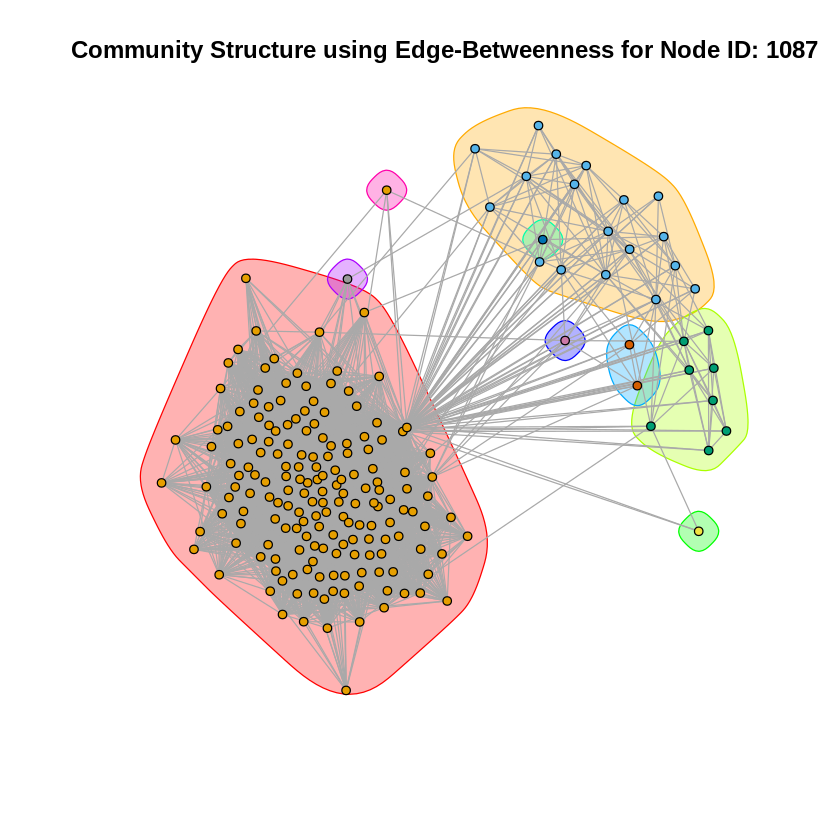

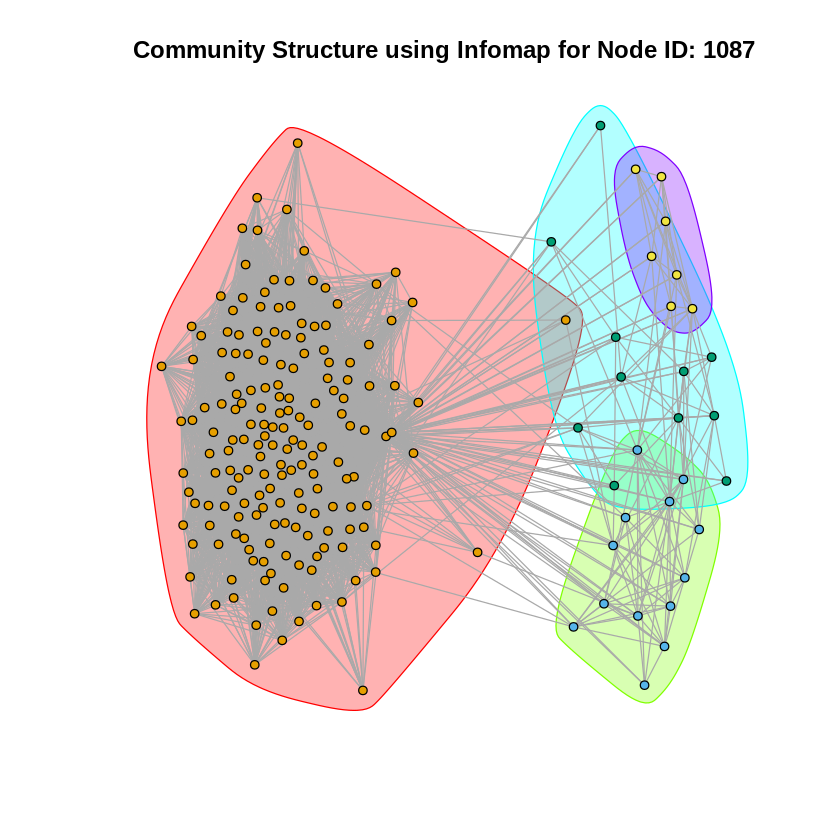

In [ ]:
#For Node ID 1087
node <- 5

# Create the personalized network for the core node
personalized_network <- eg[[node]]

# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(personalized_network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(personalized_network)
eb_modularity <- modularity(eb_clusters)


# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(personalized_network)
infomap_modularity <- modularity(infomap_clusters)

print(sprintf("Modularity using Fast Greedy for Node ID %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID: %d: %f",node_list[node], infomap_modularity))

#Plotting
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,vertex.color=eb_clusters$membership,vertex.label="",main = sprintf("Community Structure using Edge-Betweenness for Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure using Infomap for Node ID: %d", node_list[node]))


QUESTION 9: For each of the above core node’s personalized network, find the community structure using Fast-Greedy, Edge-Betweenness, and Infomap community detection algorithms. Compare the modularity scores of the algorithms. For visualization purpose, display the community structure of the core node’s personalized networks using colors. Nodes belonging to the same community should have the same color and nodes belonging to different communities should have different color. In this question, you should have 15 plots in total.
Hint Useful function(s): clusterfastgreedy , clusteredgebetweenness , clusterinfomap

> Community structure of a graph is defined as a clustering of the vertices in the network such that the number of inter cluster edges are much smaller than the number of intra cluster edges. In other words, community structures segregate regions of high connectedness from the overall sparse network structure.\
The Fast-Greedy algorithm is an efficient community detection method designed to optimize the modularity of a network. This algorithm begins by treating each node as its own community and iteratively merges communities to maximize modularity gains. In each step, it calculates the potential increase in modularity for every possible pair of community merges, selecting the pair that offers the highest increase. This process is repeated until no further increase in modularity is possible, indicating the formation of distinct communities. Due to its computational efficiency, the Fast-Greedy algorithm is particularly useful for analyzing large networks quickly.\
The Edge Betweenness algorithm is a community detection method that focuses on identifying and removing edges that serve as bridges between different communities in a network. The central concept involves calculating the "betweenness centrality" for all edges, which measures the number of shortest paths passing through each edge. In practice, edges with high betweenness centrality are critical for connecting different parts of the network, indicating potential community boundaries. The algorithm iteratively removes edges with the highest betweenness scores, which progressively fragments the network into distinct communities. This process continues until no edges remain or a predefined number of communities is reached. The Edge Betweenness algorithm is especially valuable for uncovering natural divisions within complex networks but can be computationally intensive for larger networks.\
The Infomap algorithm is a network community detection method that leverages information theory to uncover the modular structure of networks. It is based on the idea of random walks and utilizes the flow of these walks to reveal community structures. Specifically, Infomap minimizes the expected description length of a random walker's path through the network by finding a compact map description that best compresses the information in the network. This is achieved by partitioning the network into clusters (or communities) such that the random walk is highly predictable within clusters but less so between them. Infomap's effectiveness lies in its ability to detect multiple levels of communities in large and complex networks, making it a powerful tool for exploring the hierarchical organization of nodes based on the dynamics of flow within the network.

>Node Id 1:\
Modularity using Fast Greedy for Node ID 1: 0.413101\
Modularity using Edge-Betweenness for Node ID 1: 0.353302\
Modularity using Infomap for Node ID: 1: 0.389118\
Refer to the community structures above.

>Node Id 108:\
Modularity using Fast Greedy for Node ID 108: 0.435929\
Modularity using Edge-Betweenness for Node ID 108: 0.506755\
Modularity using Infomap for Node ID: 108: 0.508223\
Refer to the community structures above.

>Node Id 349:\
Modularity using Fast Greedy for Node ID 349: 0.251715\
Modularity using Edge-Betweenness for Node ID 349: 0.133528\
Modularity using Infomap for Node ID: 349: 0.095464\
Refer to the community structures above.

>Node Id 484:\
Modularity using Fast Greedy for Node ID 484: 0.507002\
Modularity using Edge-Betweenness for Node ID 484: 0.489095\
Modularity using Infomap for Node ID: 484: 0.515279\
Refer to the community structures above.

> Node Id 1087:\
Modularity using Fast Greedy for Node ID 1087: 0.145531\
Modularity using Edge-Betweenness for Node ID 1087: 0.027624\
Modularity using Infomap for Node ID: 1087: 0.026907\
Refer to the community structures above.





## QUESTION 10

[1] "Modularity using Fast Greedy for Node ID (without core node): 1: 0.441853"
[1] "Modularity using Edge-Betweenness for Node ID (without core node): 1: 0.416146"
[1] "Modularity using Infomap for Node ID (without core node): 1: 0.418008"


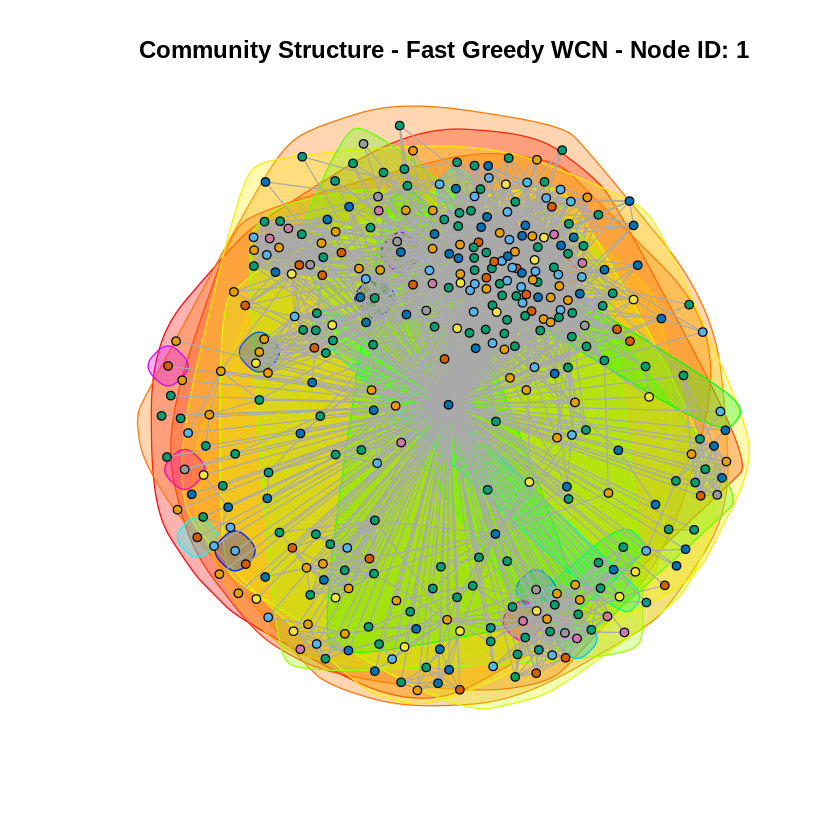

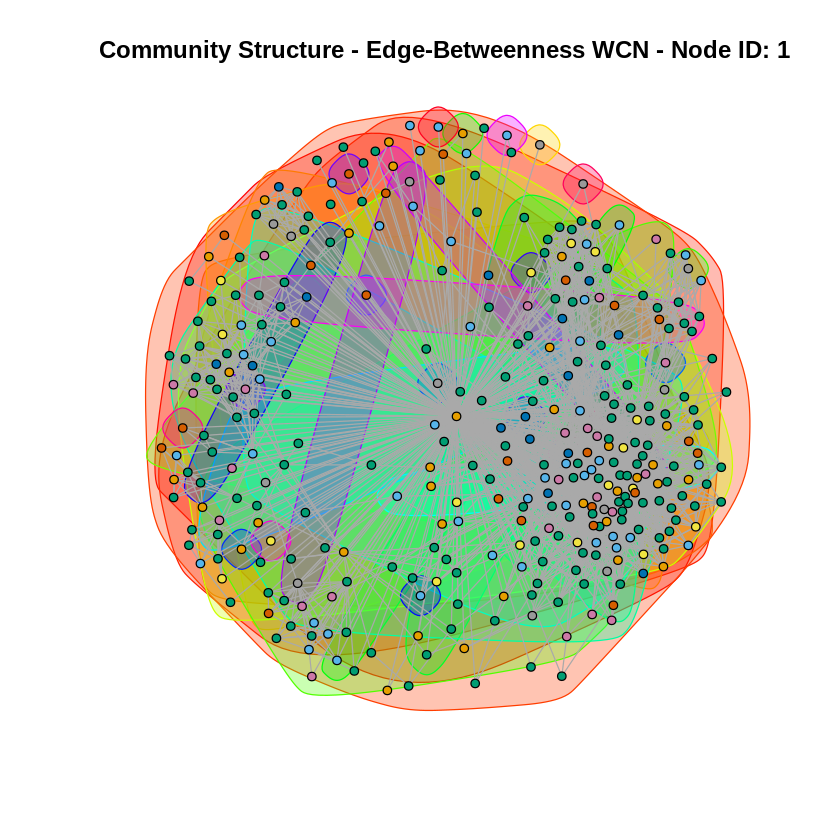

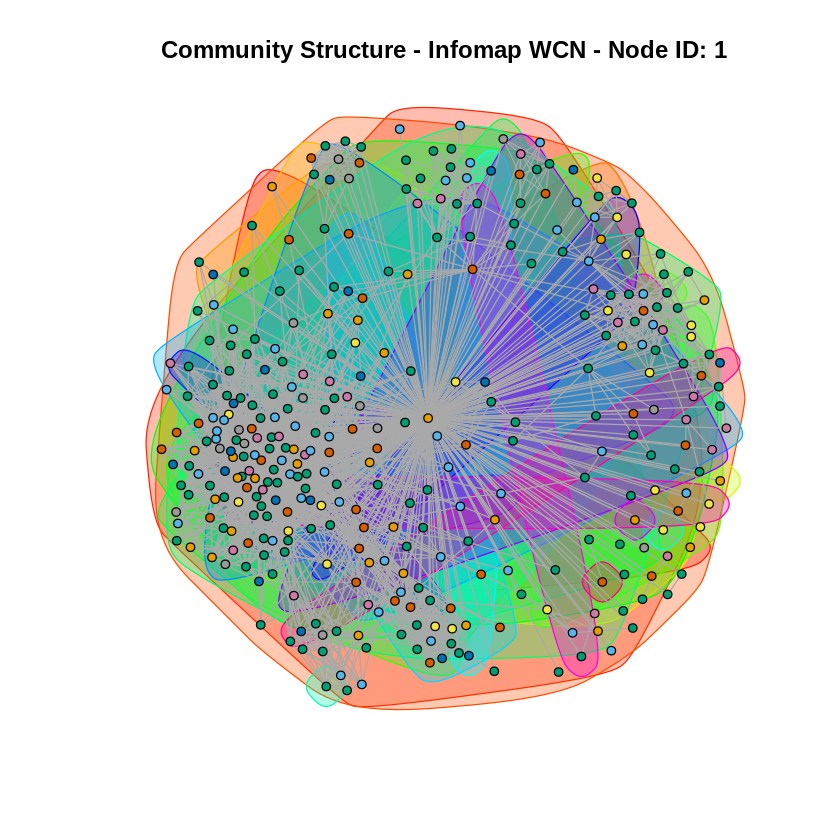

In [ ]:
#For Node ID 1
node <- 1
network <- induced_subgraph(graph, neighbors(graph, node_list[node]))
# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(network)
eb_modularity <- modularity(eb_clusters)


# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(network)
infomap_modularity <- modularity(infomap_clusters)

#Printing the modularity
print(sprintf("Modularity using Fast Greedy for Node ID (without core node): %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID (without core node): %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID (without core node): %d: %f",node_list[node], infomap_modularity))

#Plots
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure - Fast Greedy WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=eb_clusters$membership ,vertex.label="",main = sprintf("Community Structure - Edge-Betweenness WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure - Infomap WCN - Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID (without core node): 108: 0.458127"
[1] "Modularity using Edge-Betweenness for Node ID (without core node): 108: 0.521322"
[1] "Modularity using Infomap for Node ID (without core node): 108: 0.520517"


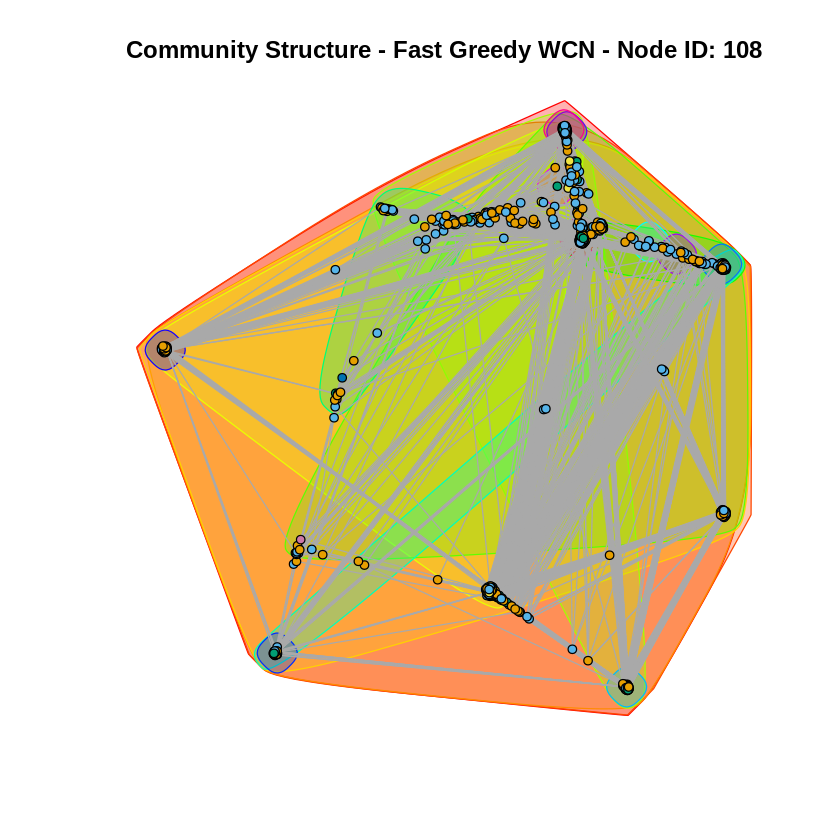

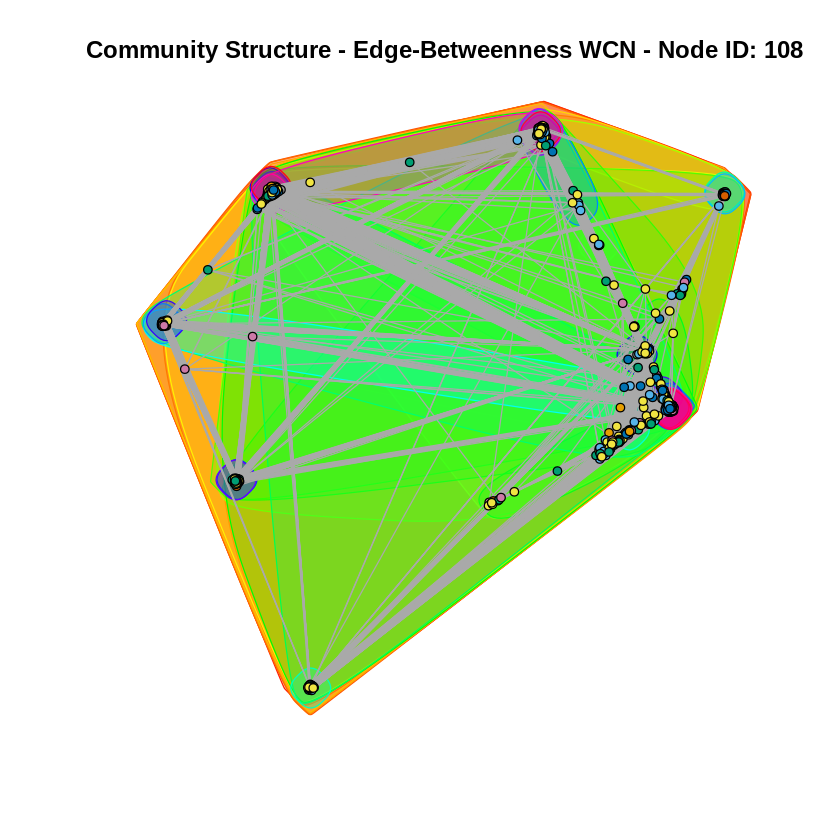

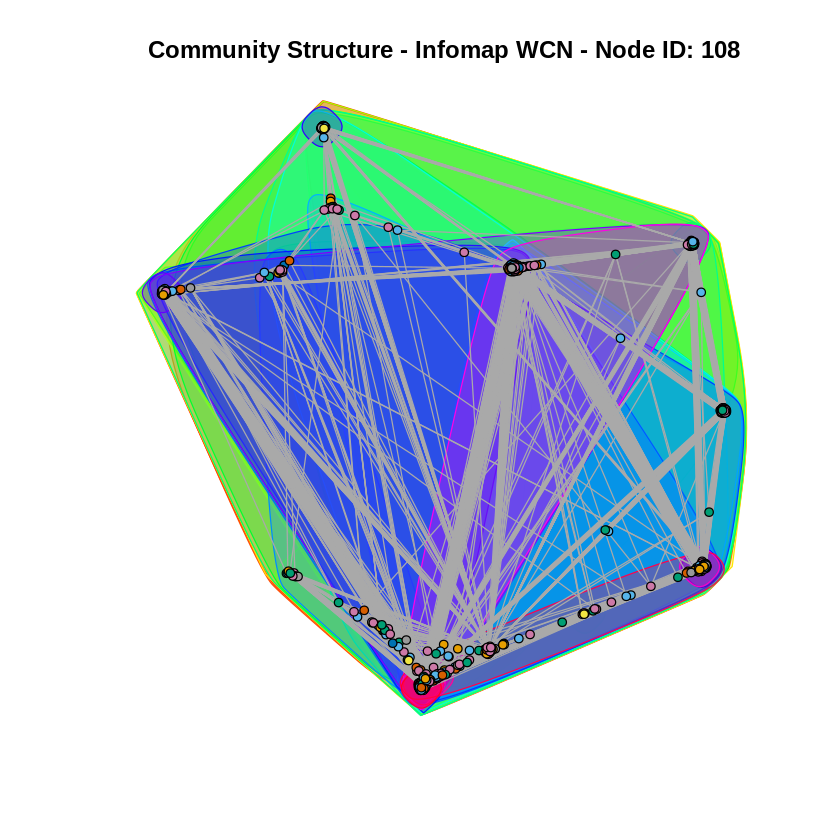

In [ ]:
#For Node ID 108
node <- 2
network <- induced_subgraph(graph, neighbors(graph, node_list[node]))
# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(network)
eb_modularity <- modularity(eb_clusters)


# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(network)
infomap_modularity <- modularity(infomap_clusters)

#Printing the modularity
print(sprintf("Modularity using Fast Greedy for Node ID (without core node): %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID (without core node): %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID (without core node): %d: %f",node_list[node], infomap_modularity))

#Plots
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure - Fast Greedy WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=eb_clusters$membership ,vertex.label="",main = sprintf("Community Structure - Edge-Betweenness WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure - Infomap WCN - Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID (without core node): 349: 0.245692"
[1] "Modularity using Edge-Betweenness for Node ID (without core node): 349: 0.150566"
[1] "Modularity using Infomap for Node ID (without core node): 349: 0.246578"


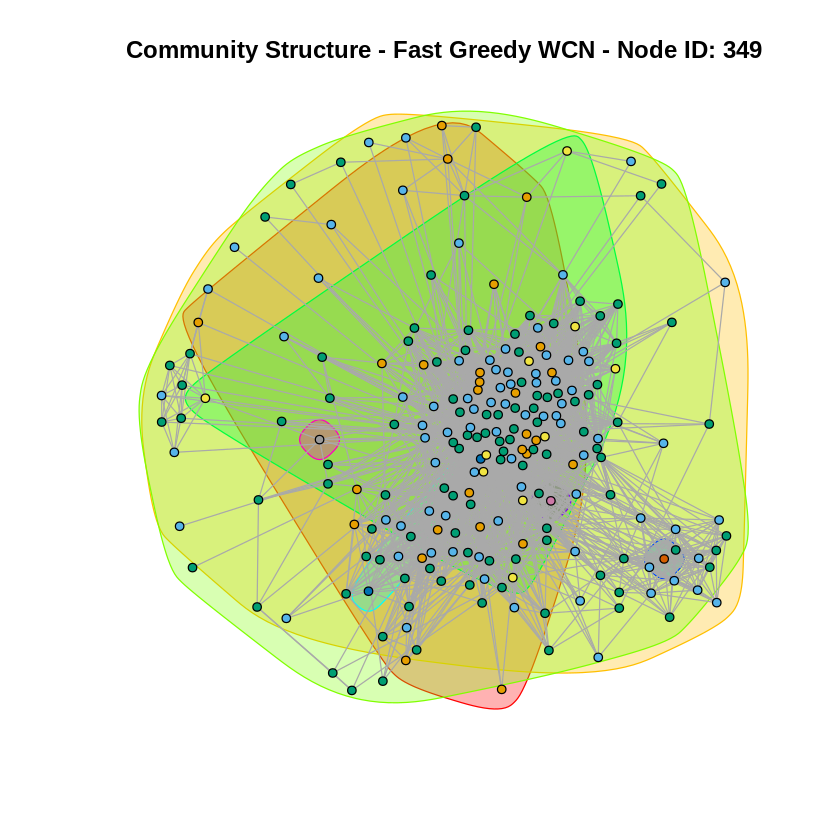

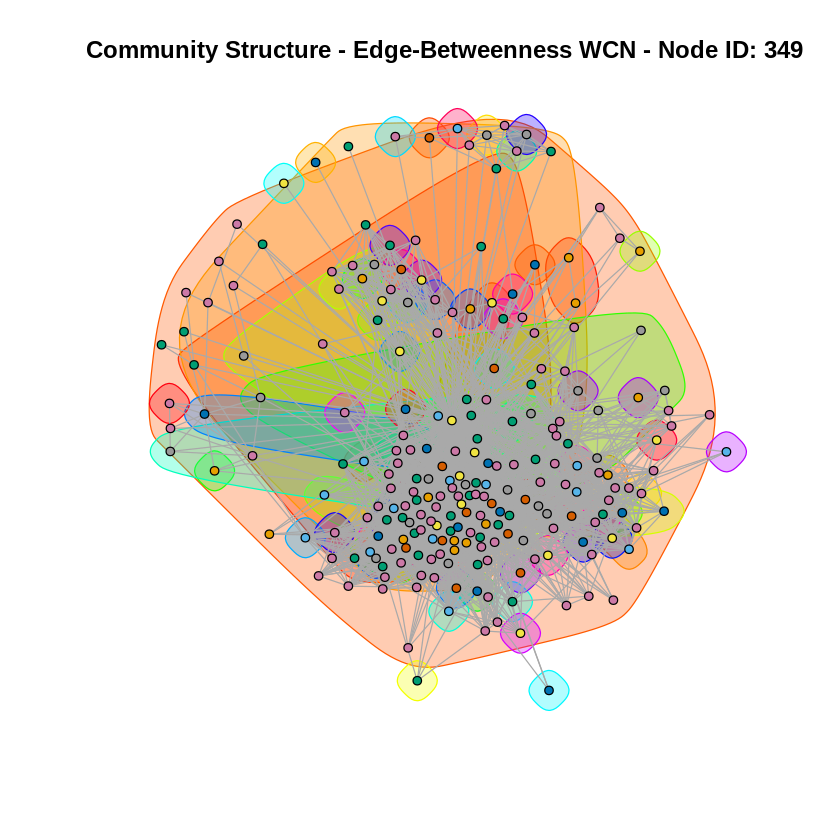

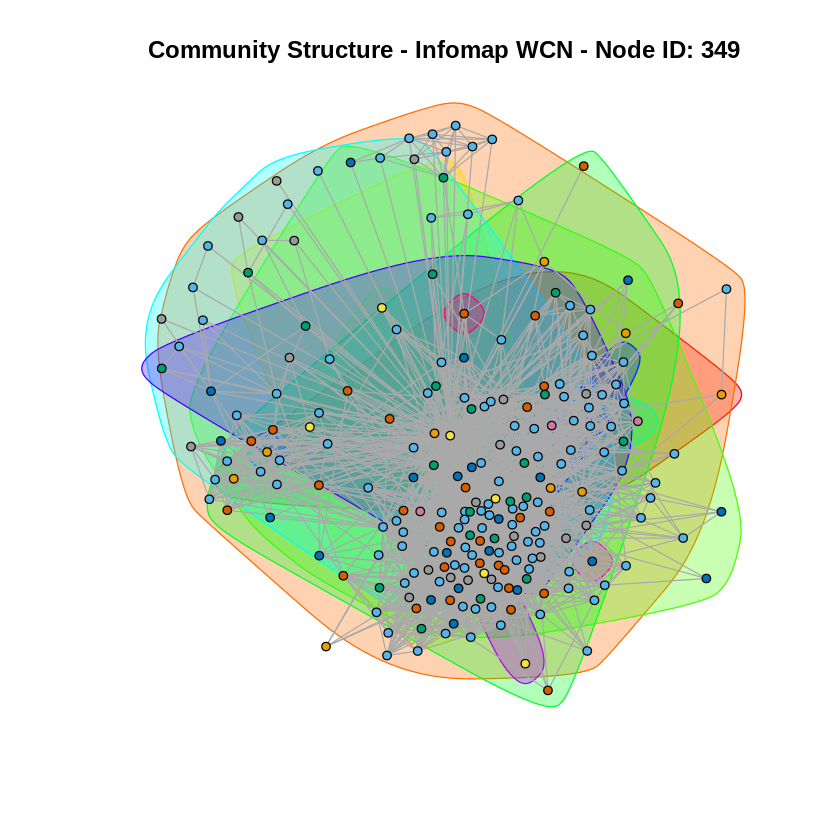

In [ ]:
#For Node ID 349
node <- 3
network <- induced_subgraph(graph, neighbors(graph, node_list[node]))
# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(network)
eb_modularity <- modularity(eb_clusters)


# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(network)
infomap_modularity <- modularity(infomap_clusters)

#Printing the modularity
print(sprintf("Modularity using Fast Greedy for Node ID (without core node): %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID (without core node): %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID (without core node): %d: %f",node_list[node], infomap_modularity))

#Plots
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure - Fast Greedy WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=eb_clusters$membership ,vertex.label="",main = sprintf("Community Structure - Edge-Betweenness WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure - Infomap WCN - Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID (without core node): 484: 0.534214"
[1] "Modularity using Edge-Betweenness for Node ID (without core node): 484: 0.515441"
[1] "Modularity using Infomap for Node ID (without core node): 484: 0.543444"


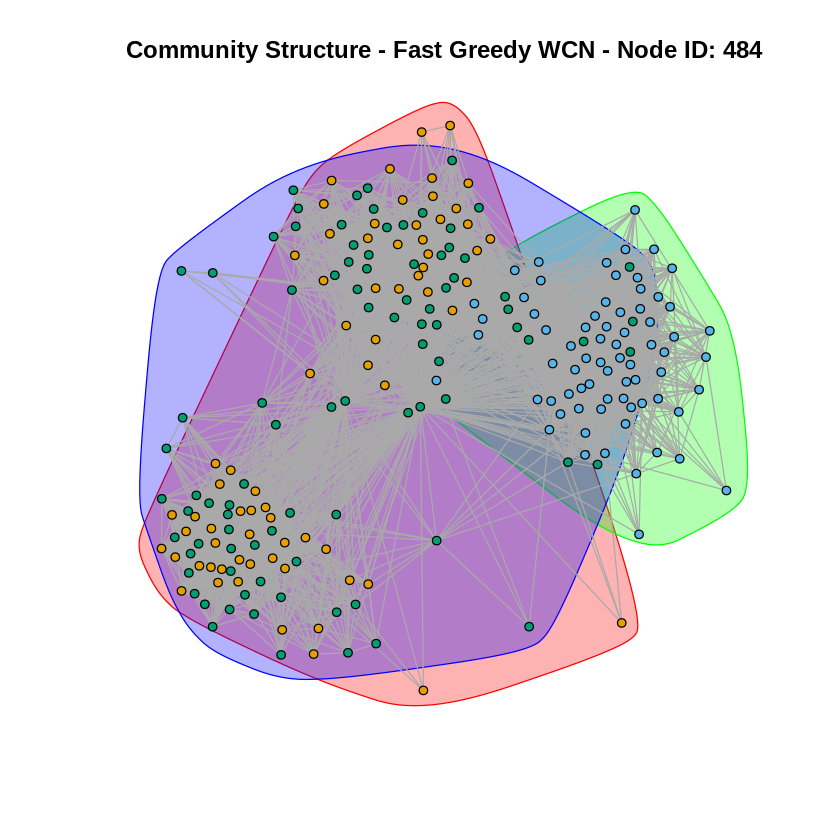

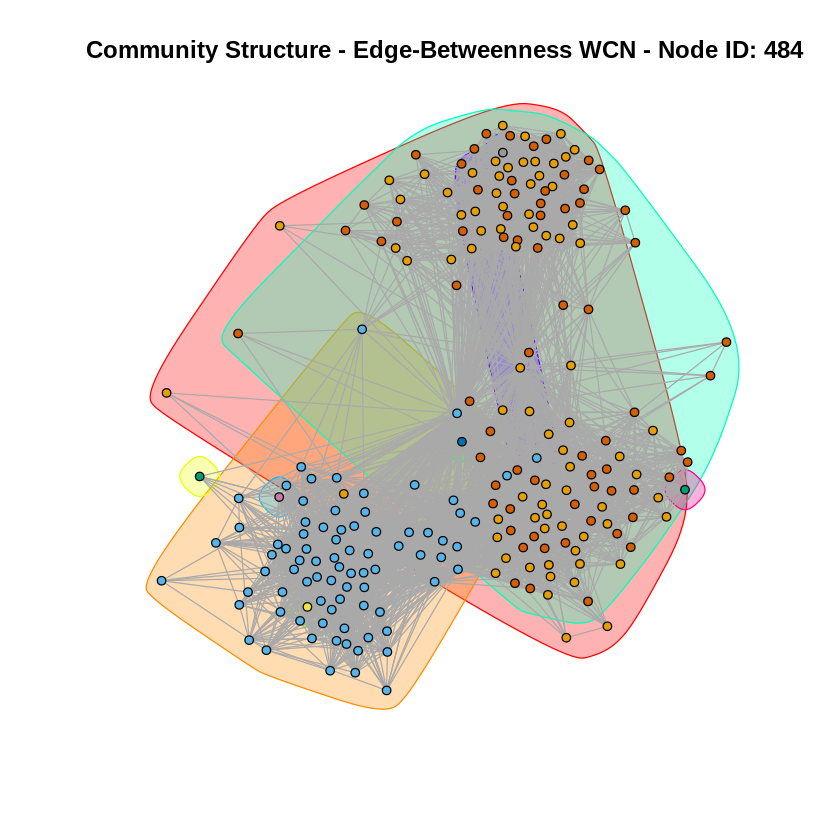

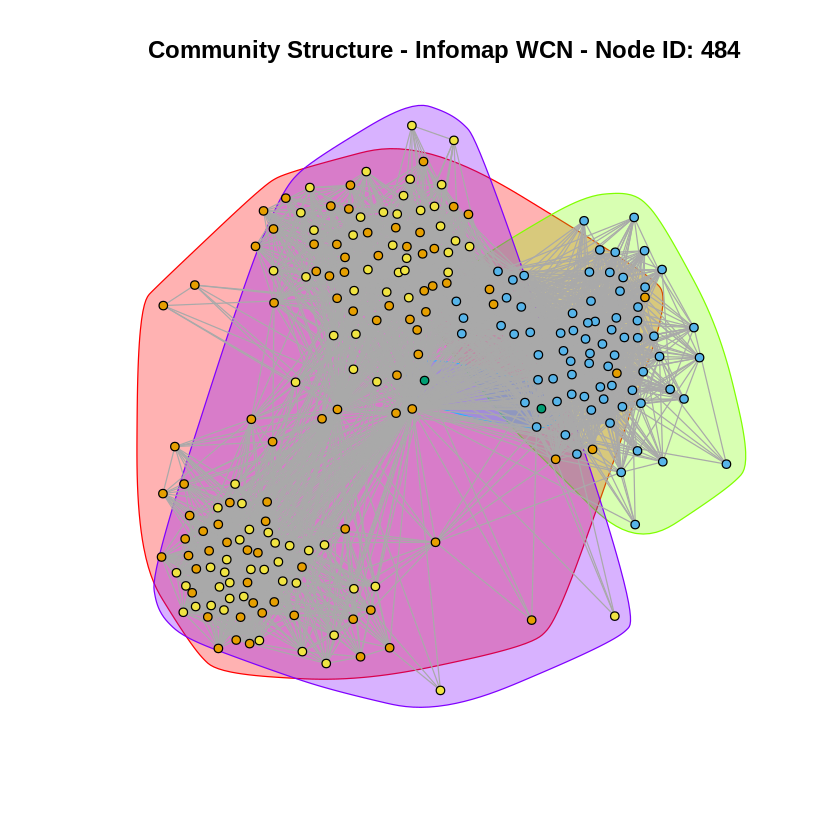

In [ ]:
#For Node ID 484
node <- 4
network <- induced_subgraph(graph, neighbors(graph, node_list[node]))
# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(network)
eb_modularity <- modularity(eb_clusters)


# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(network)
infomap_modularity <- modularity(infomap_clusters)

#Printing the modularity
print(sprintf("Modularity using Fast Greedy for Node ID (without core node): %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID (without core node): %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID (without core node): %d: %f",node_list[node], infomap_modularity))

#Plots
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure - Fast Greedy WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=eb_clusters$membership ,vertex.label="",main = sprintf("Community Structure - Edge-Betweenness WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure - Infomap WCN - Node ID: %d", node_list[node]))

[1] "Modularity using Fast Greedy for Node ID (without core node): 1087: 0.148196"
[1] "Modularity using Edge-Betweenness for Node ID (without core node): 1087: 0.032495"
[1] "Modularity using Infomap for Node ID (without core node): 1087: 0.027372"


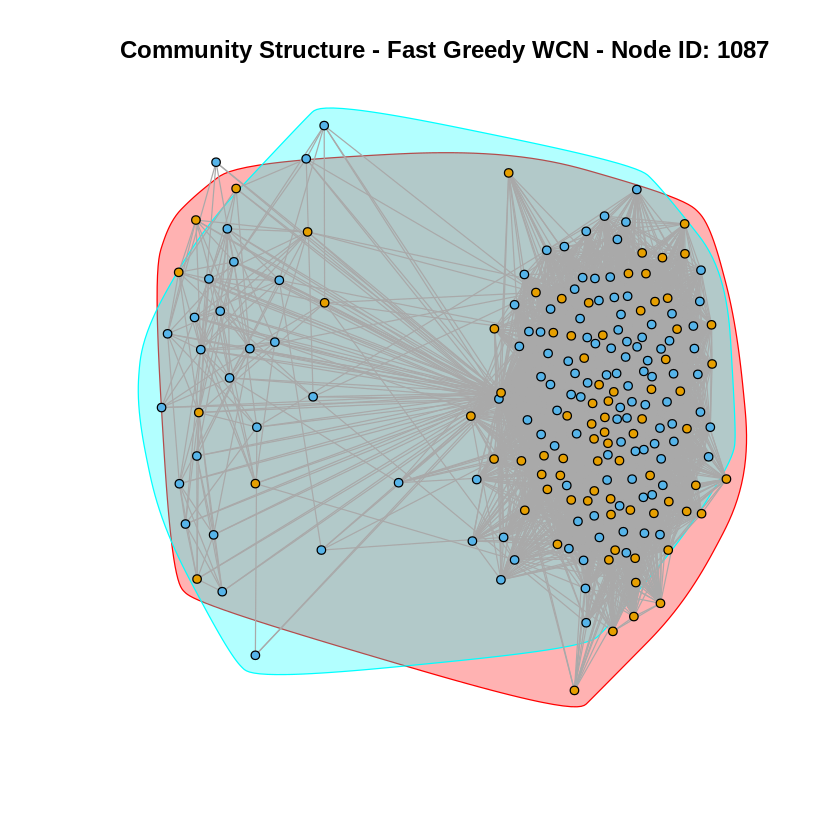

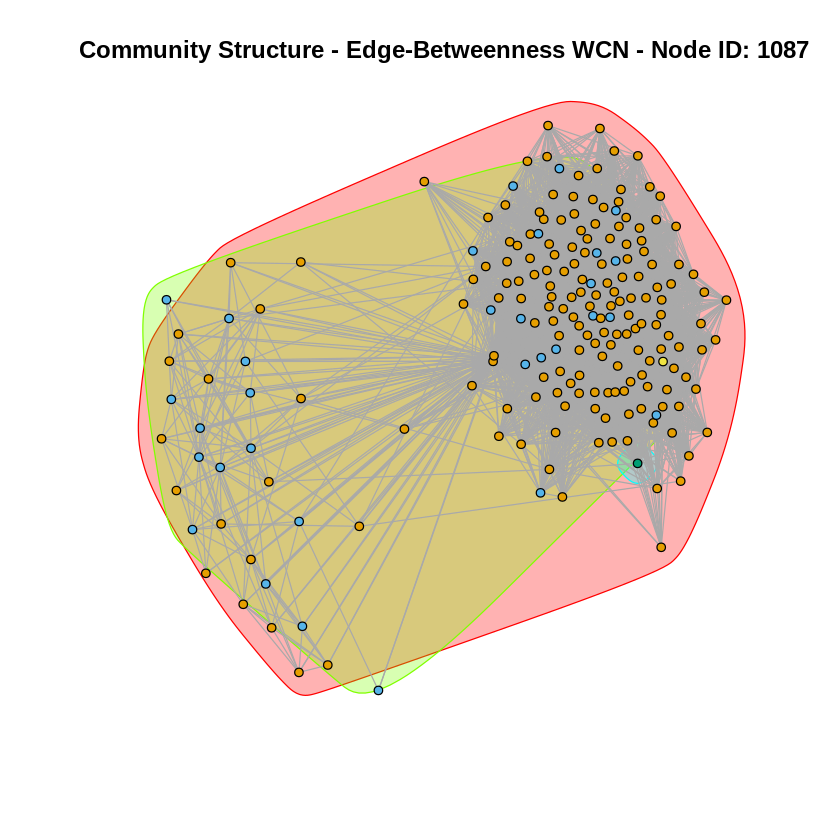

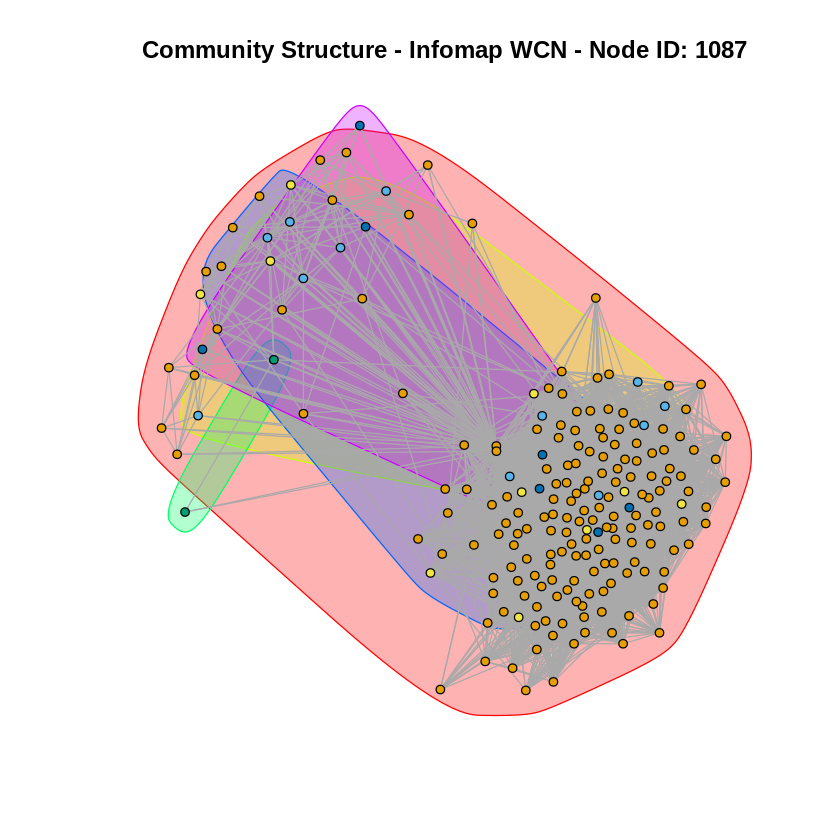

In [ ]:
#For Node ID 1087
node <- 5
network <- induced_subgraph(graph, neighbors(graph, node_list[node]))
# Community detection using Fast-Greedy algorithm
fg_clusters <- cluster_fast_greedy(network)
fg_modularity <- modularity(fg_clusters)

# Community detection using Edge-Betweenness algorithm
eb_clusters <- cluster_edge_betweenness(network)
eb_modularity <- modularity(eb_clusters)


# Community detection using Infomap algorithm
infomap_clusters <- cluster_infomap(network)
infomap_modularity <- modularity(infomap_clusters)

#Printing the modularity
print(sprintf("Modularity using Fast Greedy for Node ID (without core node): %d: %f",node_list[node], fg_modularity))
print(sprintf("Modularity using Edge-Betweenness for Node ID (without core node): %d: %f",node_list[node], eb_modularity))
print(sprintf("Modularity using Infomap for Node ID (without core node): %d: %f",node_list[node], infomap_modularity))

#Plots
plot(eg[[node]],mark.groups = fg_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=fg_clusters$membership,vertex.label="",main = sprintf("Community Structure - Fast Greedy WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = eb_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=eb_clusters$membership ,vertex.label="",main = sprintf("Community Structure - Edge-Betweenness WCN - Node ID: %d", node_list[node]))
plot(eg[[node]],mark.groups = infomap_clusters,vertex.size=3,edge.arrow.size=.5,vertex.color=infomap_clusters$membership,vertex.label="",main = sprintf("Community Structure - Infomap WCN - Node ID: %d", node_list[node]))

QUESTION 10: For each of the core node’s personalized network (use same core nodes as Question 9), remove the core node from the personalized network and find the community structure of the modified personalized network. Use the same community detection algorithm as Question 9. Compare the modularity score of the community structure of the modified personalized network with the modularity score of the community structure of the personalized network of Question 9. For visualization purpose, display the community structure of the modified personalized network using colors. In this question, you should have 15 plots in total.

> Node Id 1:\
Modularity using Fast Greedy for Node ID (without core node): 1: 0.441853\
Modularity using Edge-Betweenness for Node ID (without core node): 1: 0.416146\
Modularity using Infomap for Node ID (without core node): 1: 0.418008\
Refer to the community structures above.

>Node Id 108:\
Modularity using Fast Greedy for Node ID (without core node): 108: 0.458127\
Modularity using Edge-Betweenness for Node ID (without core node): 108: 0.521322\
Modularity using Infomap for Node ID (without core node): 108: 0.520517\
Refer to the community structures above.

> Node Id 349:\
Modularity using Fast Greedy for Node ID (without core node): 349: 0.245692\
Modularity using Edge-Betweenness for Node ID (without core node): 349: 0.150566\
Modularity using Infomap for Node ID (without core node): 349: 0.246578\
Refer to the community structures above.

>Node Id 484:\
Modularity using Fast Greedy for Node ID (without core node): 484: 0.534214\
Modularity using Edge-Betweenness for Node ID (without core node): 484: 0.515441\
Modularity using Infomap for Node ID (without core node): 484: 0.543444\
Refer to the community structures above.

> Node Id 1087:\
Modularity using Fast Greedy for Node ID (without core node): 1087: 0.148196\
Modularity using Edge-Betweenness for Node ID (without core node): 1087: 0.032495\
Modularity using Infomap for Node ID (without core node): 1087: 0.027372\
Refer to the community structures above.


> We can see that the modularity scores have increased after removing the core node for all 5 personalized networks. This is because the core node acts as the bridge between all of the other nodes, which causes the network with the core node less capable of being partitioned into communities with strong intra-community connectedness and sparse inter-community connectedness compared to the network without the core node. With the presence of the core node, it is difficult to classify the core node into a single community as it is connected to every other node while also making it difficult to assign densely packed and sparsely inter-connected communities among the other nodes, resulting in a dense network with low modularity. In addition, with the core node present, the other nodes are not always directly connected to each other or the rest of the graph, resulting in many isolated communities (communities with a single node) for edge-betweenness. With the core node removed, the edges from the core node to all other nodes are removed, allowing the community partition algorithms to find densely packed areas of high connectedness with sparse inter-community edges. The probability of strong intra-community connections is greater for networks with core nodes removed, and likewise, the extent of sparsity among communities is amplified in such networks. We can also see that all the algorithms, especially edge-betweenness, have a decreased tendency of forming groups with isolated nodes. In addition, the community structures are still well-defined and well-partitioned, despite absence of the core nodes.


## QUESTION 11

QUESTION 11: Write an expression relating the Embeddedness between the core node and a non-core node to the degree of the non-core node in the personalized network of the core node.

>Embeddedness in a network, specifically within the context of a core node and a non-core node in a personalized network, measures the number of shared neighbors between the two nodes. The embeddedness between the core node c and the non-core node v, denoted as E(c,v), can be defined as the number of common neighbors between c and v. The degree of the non-core node v in the personalized network, denoted as deg(v), is the total number of connections v has within this network. The embeddedness of a node is defined as the number of mutual vertices a given node shares with the core node. Embeddedness is
defined as the overlap in the social circle of two users.
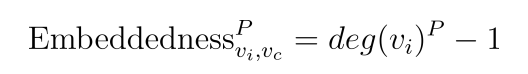
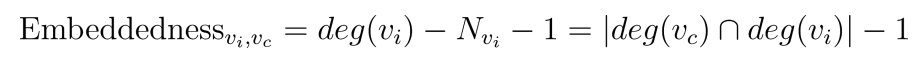

## QUESTION 12

Warning message:
“`graph.data.frame()` was deprecated in igraph 2.0.0.
Please use `graph_from_data_frame()` instead.”


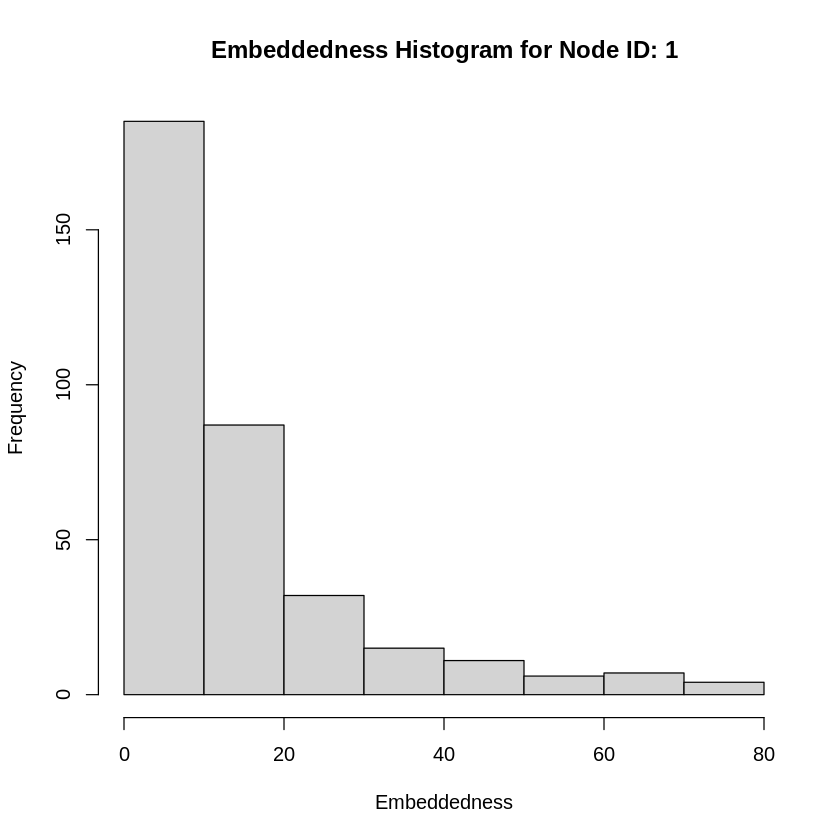

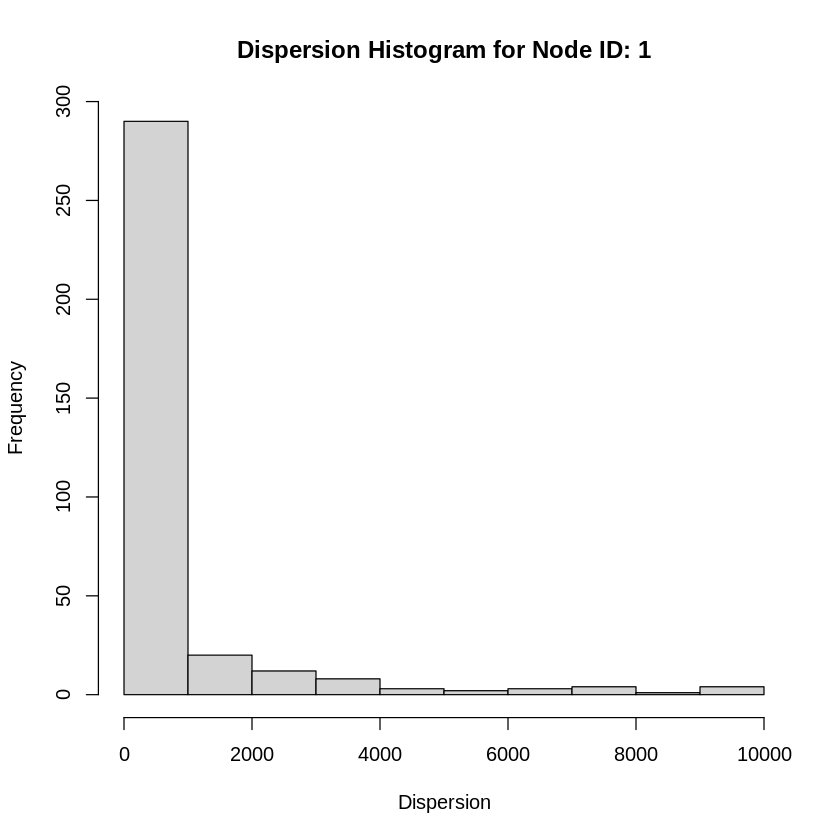

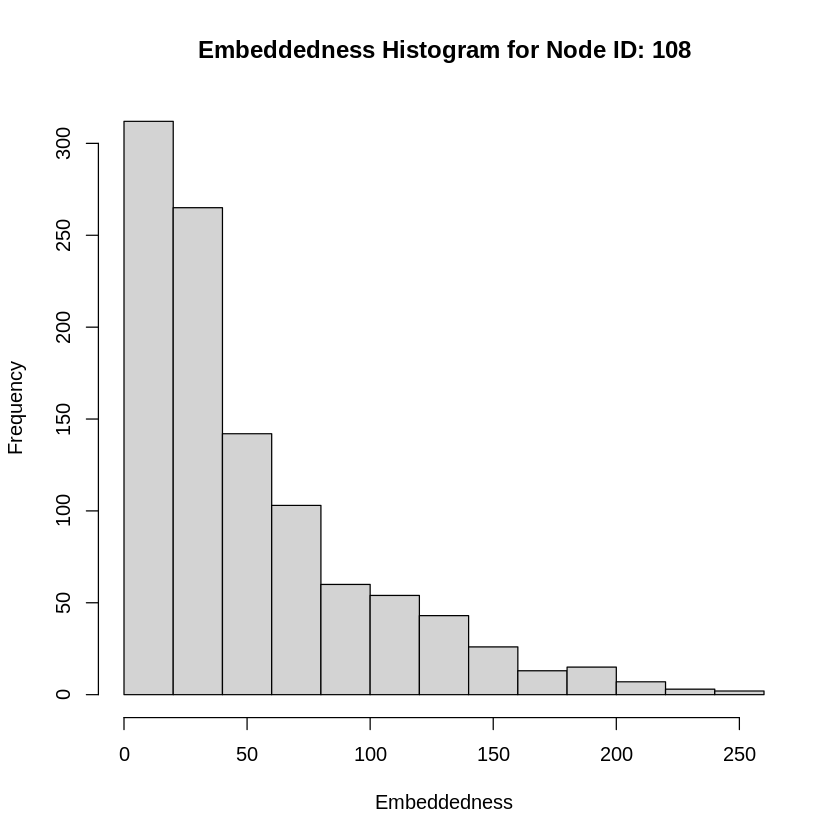

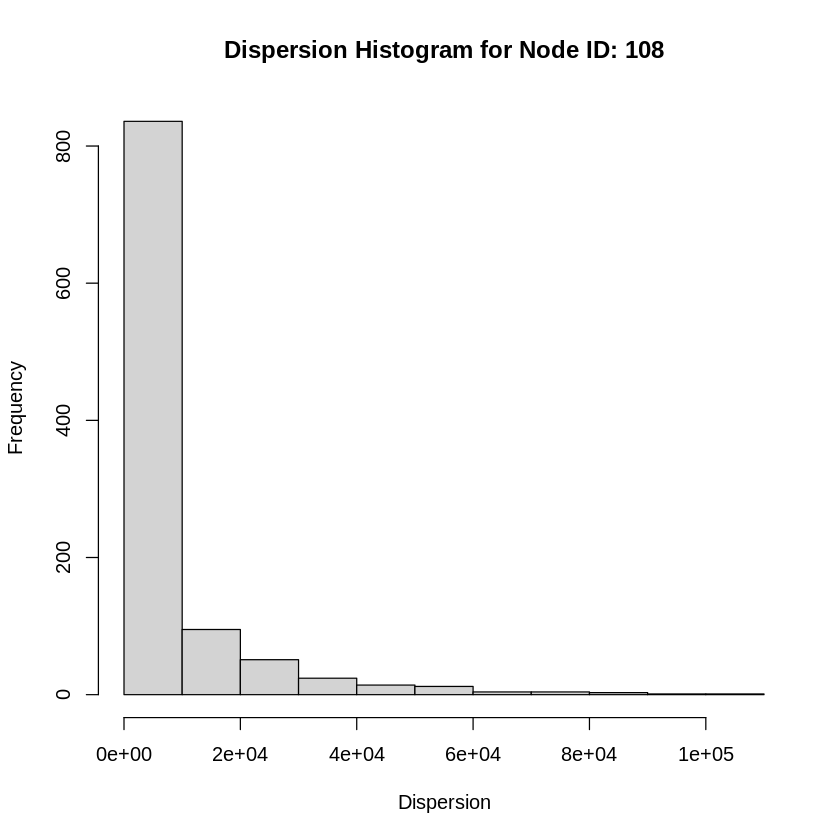

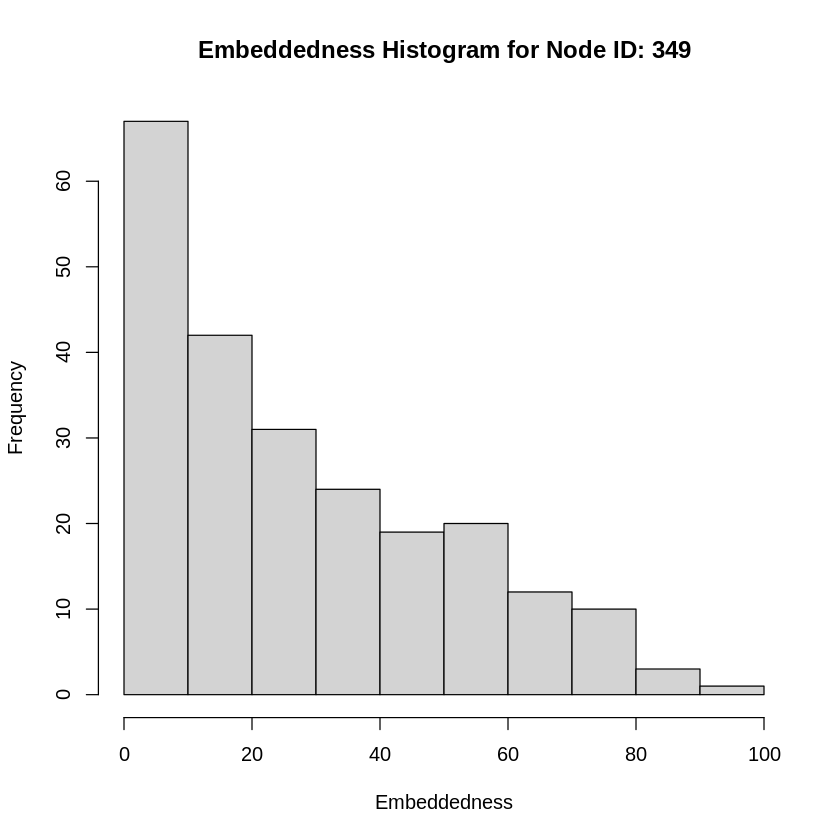

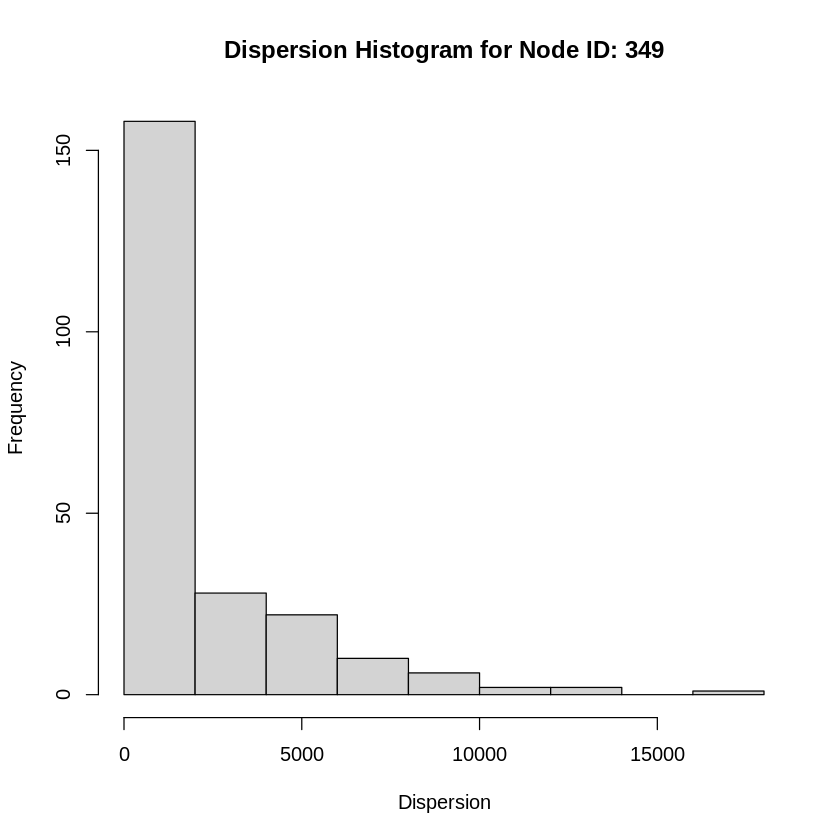

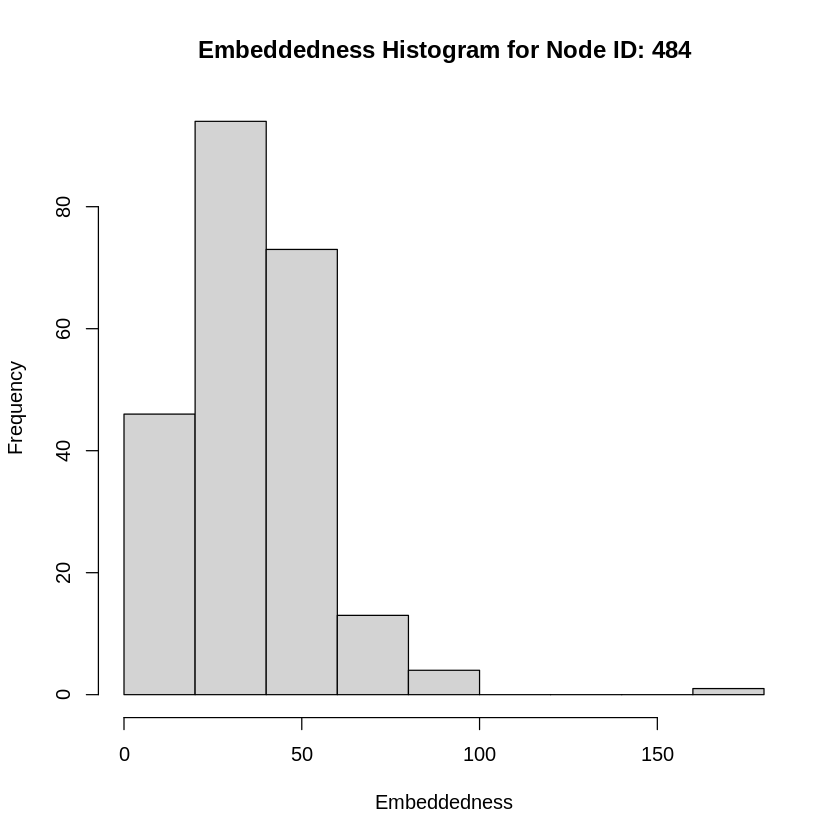

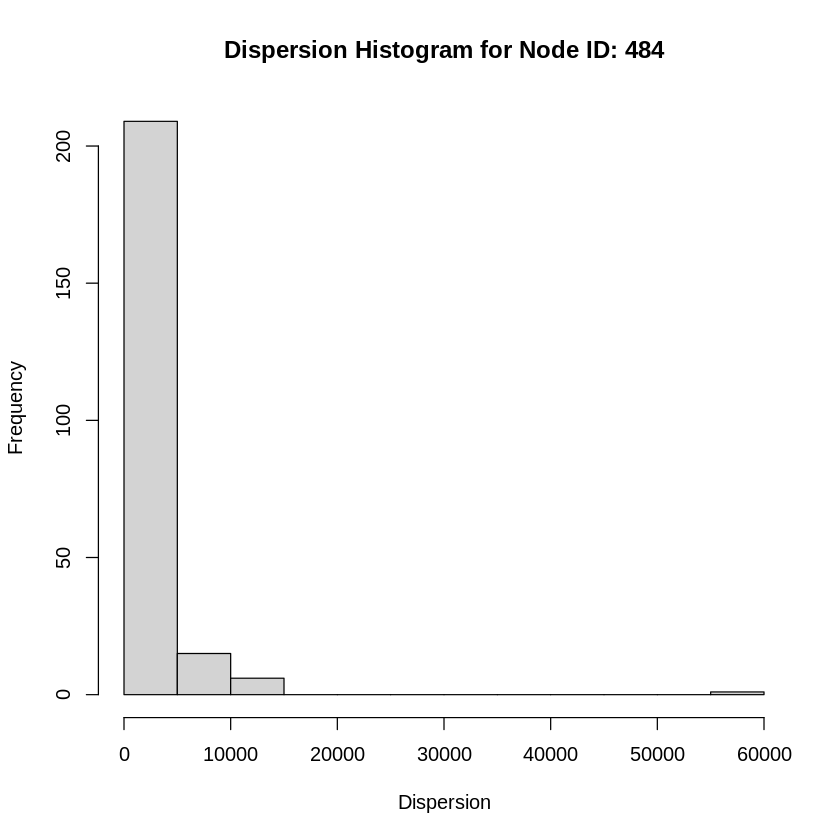

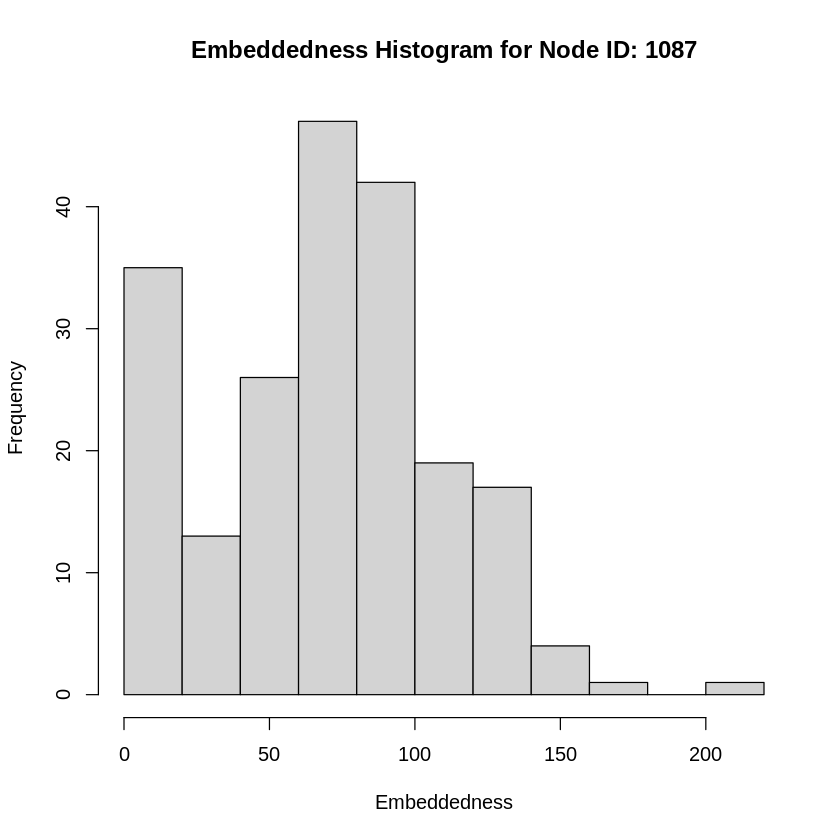

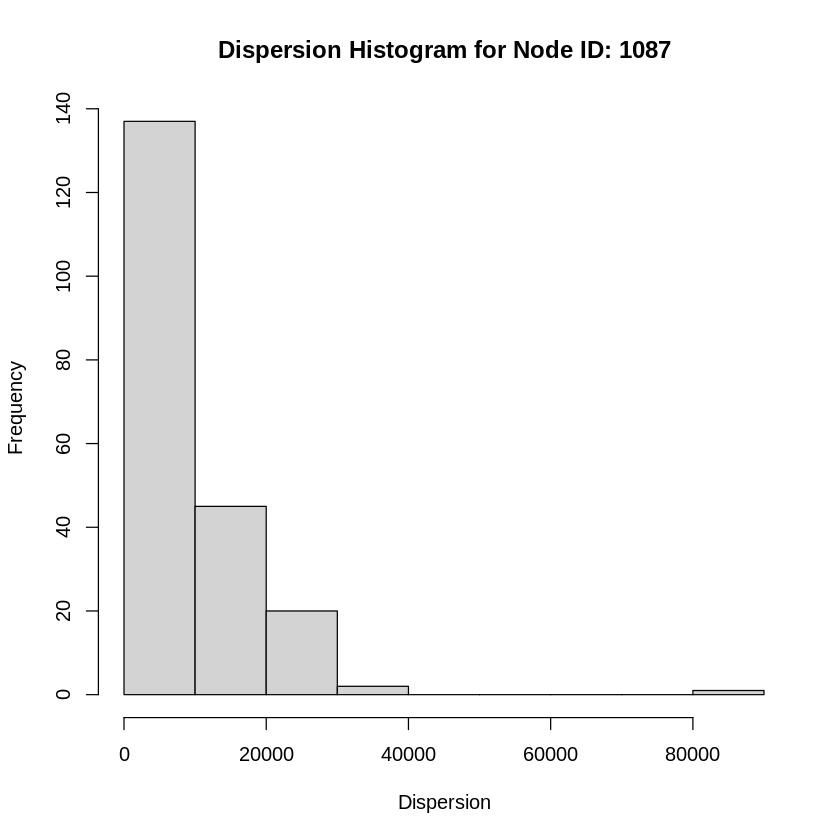

In [ ]:
# Read the data into R
data <- read.table(gzfile(destfile))

# Assuming the data contains an edge list with two columns: "from" and "to"
edges <- data.frame(from = data$V1, to = data$V2)

# Create the graph
graph <- graph.data.frame(edges, directed = FALSE)
# Define nodes of interest (adjust these IDs based on your actual graph IDs)
node_list_str = c("0","107","348","483","1086")

# Iterate over each node in the list to process their personalized networks
for(j in c(1:5)){

    # Create the ego network for the node
    nodelist = unlist(ego(graph, order=1, nodes=node_list_str[j]))
    personalized_network = induced_subgraph(graph,nodelist)
    personalized_network$name = sort(nodelist)
    embeddedness <- c()
    disp <- c()
    deg <- c()
    i=1
    for(v in vertex_attr(personalized_network)$name){
        if(v==node_list_str[j])
            next

        disp[i] = 0
        # Get all neighbors of the core node
        neighbor_ver = neighbors(personalized_network, node_list_str[j])
        neighbor_core = neighbors(personalized_network,v)
        inter = intersection(neighbor_ver, neighbor_core)
        embeddedness[i] = length(inter)

        deg[i] = degree(personalized_network,v)
        eg2 = delete_vertices(personalized_network, c(node_list_str[j], v))
        #Computer dispersion and embeddedness
        if(embeddedness[i]>1){
            ver = c()
            for(m in 1:length(inter)){
                ver =  c(ver,vertex_attr(personalized_network)$name[inter[m]])
            }
            ver1=c()
            for(m in 1:length(ver)){
                ver1=c(ver1,which(vertex_attr(eg2)$name==ver[m]))
            }
            disp_mat = distances(eg2,v=ver1, to=ver1)
            disp_mat[disp_mat==Inf]<-diameter(eg2)+1
            disp[i] = sum(disp_mat)
        }
        i=i+1

    }
    #Plotting the histogram
    hist(embeddedness,main=sprintf("Embeddedness Histogram for Node ID: %d",strtoi(node_list_str[j])+1), xlab="Embeddedness",ylab="Frequency")
    hist(disp,main=sprintf("Dispersion Histogram for Node ID: %d",strtoi(node_list_str[j])+1), xlab="Dispersion",ylab="Frequency")
}

QUESTION 12: For each of the core node’s personalized network (use the same core nodes as Question 9), plot the distribution histogram of embeddedness and dispersion. In this question, you will have 10 plots.
Hint Useful function(s): neighbors , intersection , distances

> Dispersion of a node is defined as the sum of distances between every pair of the mutual vertices the node shares with the core node, calculated in a modified subgraph graph with the target node and core node removed.
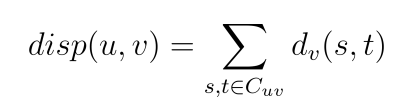

> Refer to the plots above for embeddedness and dispersion. From the plots above, we can see that the range of dispersions depends on the number of edges (degree) of the core node in the personalized network, the higher the number of edges, the higher is the dispersion. In addition, the expected value of embeddedness is dependent on the number of edges in the personalized network. Both embeddedness and dispersion roughly follow the power-law distribution due to their inherent relation with the degree distribution of the personalized networks, which follow power-law distribution stemming from weak preferential attachment. Dispersion measures the extent to which two people’s mutual friends are not themselves well-connected, in other words, the mutual nodes of two strongly connected nodes are not well connected and must display a dispersed structure. Embeddedness depends on the number of nodes in the personalized network. The higher the number of nodes and connectivity among them in the social circle, the greater is the embeddedness, even though embeddedness is not a good indicator of strong ties, as strongly tied nodes may have low degrees of embeddedness.


## QUESTION 13

Warning message:
“`graph.data.frame()` was deprecated in igraph 2.0.0.
Please use `graph_from_data_frame()` instead.”


[1] "Node with Maximum Dispersion for Node Id 1 is : 49"


Warning message in as_edgelist(personalized_network, name = FALSE)[, 1] == maxnode | :
“longer object length is not a multiple of shorter object length”


[1] "Node with Maximum Dispersion for Node Id 108 is : 977"
[1] "Node with Maximum Dispersion for Node Id 349 is : 31"


Warning message in as_edgelist(personalized_network, name = FALSE)[, 1] == maxnode | :
“longer object length is not a multiple of shorter object length”


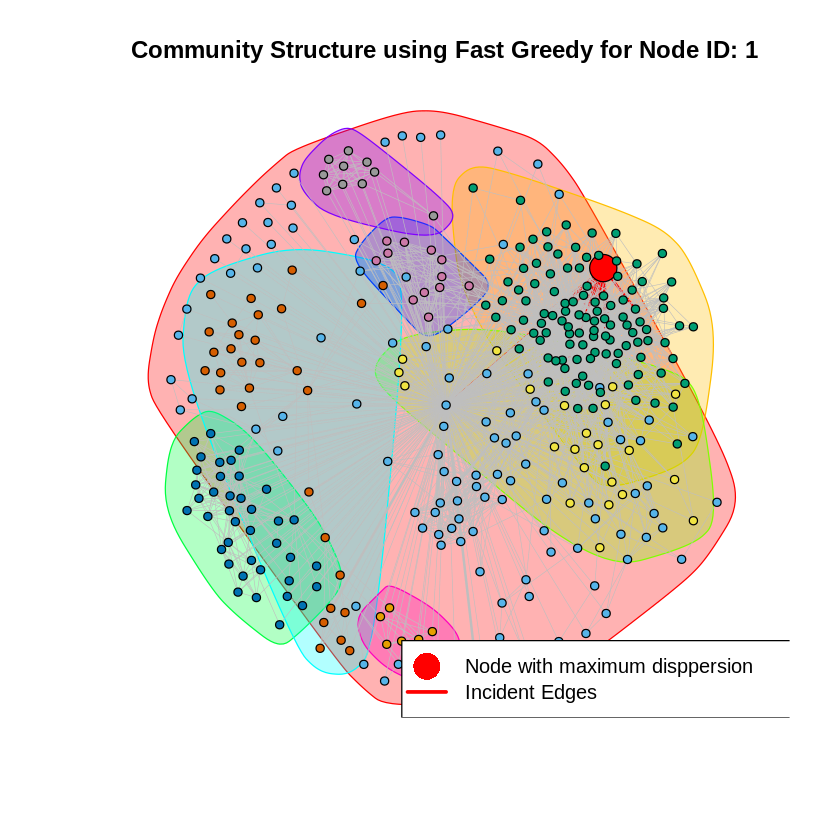

[1] "Node with Maximum Dispersion for Node Id 484 is : 1"


Warning message in as_edgelist(personalized_network, name = FALSE)[, 1] == maxnode | :
“longer object length is not a multiple of shorter object length”


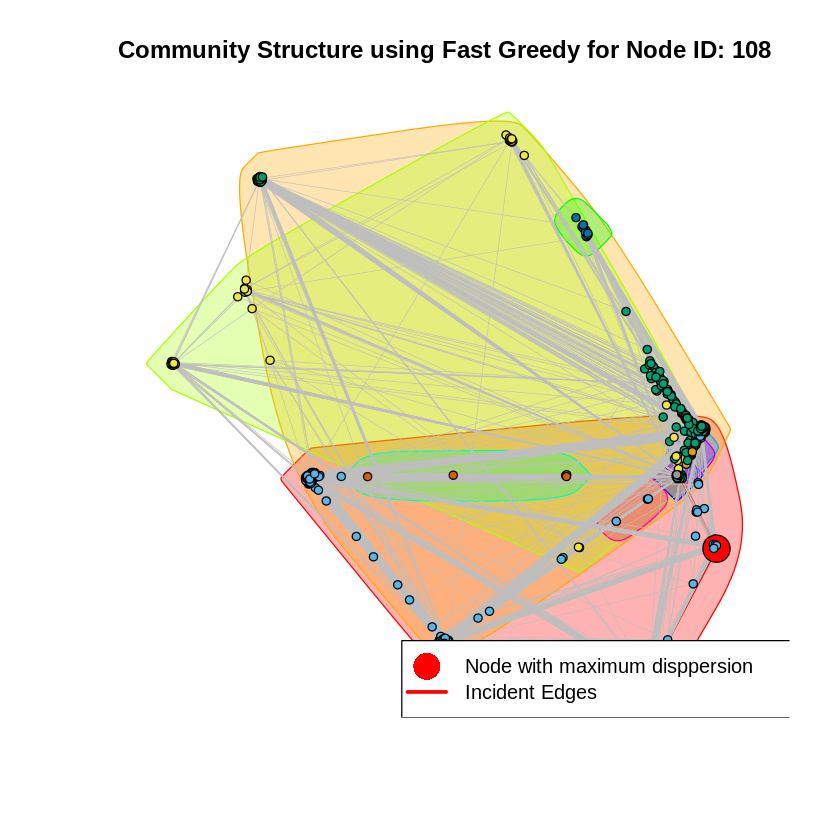

[1] "Node with Maximum Dispersion for Node Id 1087 is : 1"


Warning message in as_edgelist(personalized_network, name = FALSE)[, 1] == maxnode | :
“longer object length is not a multiple of shorter object length”


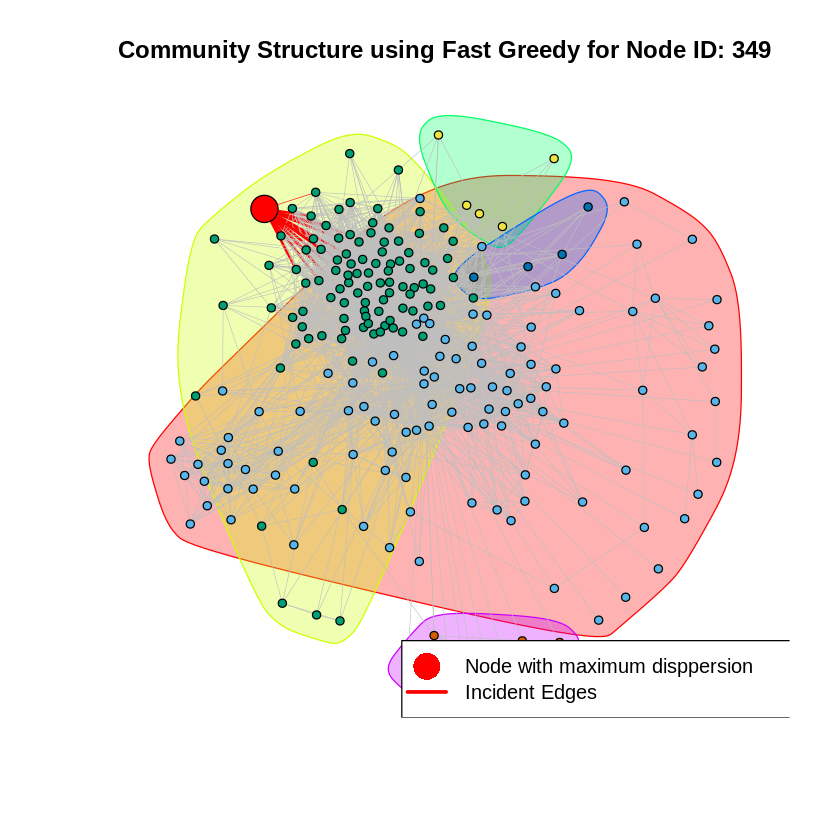

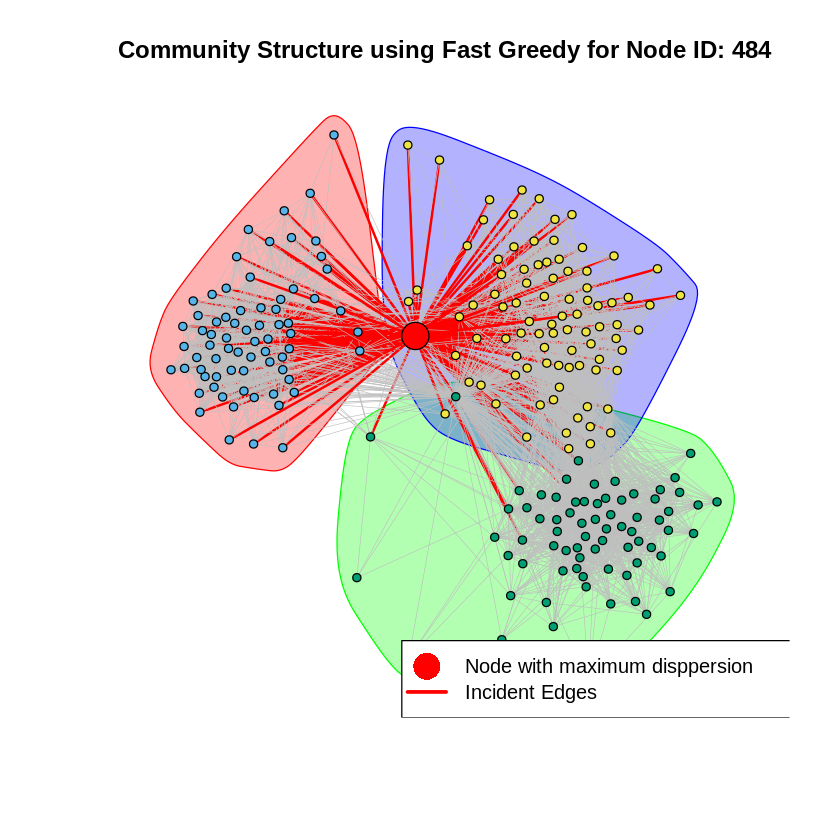

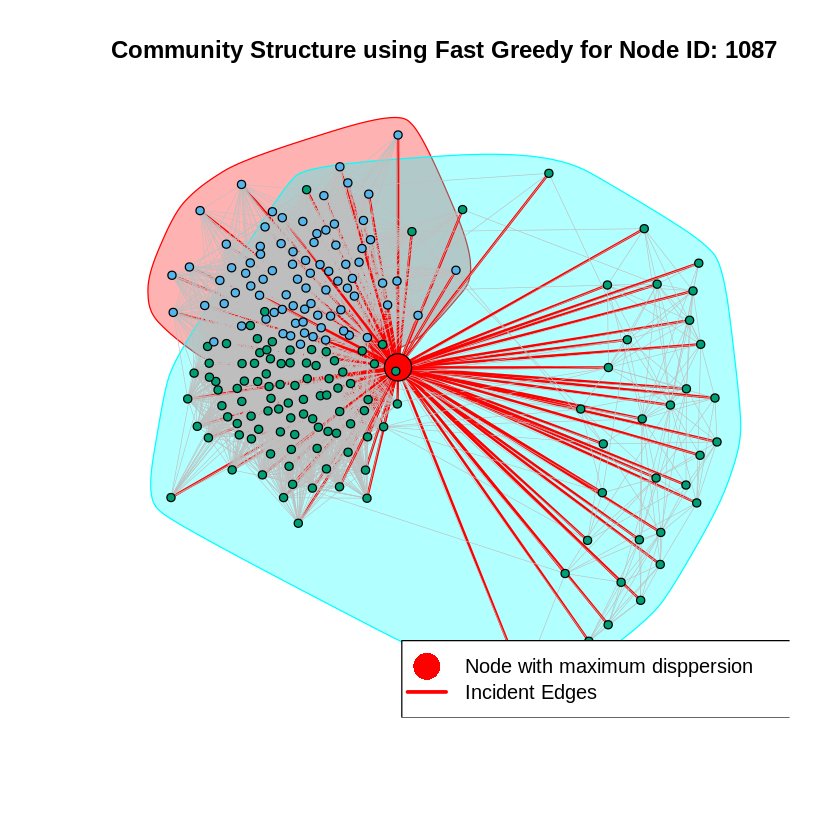

In [ ]:
# Read the data into R
data <- read.table(gzfile(destfile))

# Assuming the data contains an edge list with two columns: "from" and "to"
edges <- data.frame(from = data$V1, to = data$V2)

# Create the graph
graph <- graph.data.frame(edges, directed = FALSE)
for(j in c(1:5)){
    # Create the ego network for the node
    nodelist = unlist(ego(graph, order=1, nodes=node_list_str[j]))
    personalized_network = induced_subgraph(graph,nodelist)
    personalized_network$name = sort(nodelist)
    embeddedness <- c()
    disp <- c()
    deg <- c()
    i=1
    for(v in vertex_attr(personalized_network)$name){
        if(v==node_list_str[j])
            next

        disp[i] = 0
        #Find all the neighbours of the core node
        neighbor_ver = neighbors(personalized_network, node_list_str[j])
        neighbor_core = neighbors(personalized_network,v)
        inter = intersection(neighbor_ver, neighbor_core)
        embeddedness[i] = length(inter)

        deg[i] = degree(personalized_network,v)
        eg2 = delete_vertices(personalized_network, c(node_list_str[j], v))
        if(embeddedness[i]>1){
            ver = c()
            for(m in 1:length(inter)){
                ver =  c(ver,vertex_attr(personalized_network)$name[inter[m]])
            }
            ver1=c()
            for(m in 1:length(ver)){
                ver1=c(ver1,which(vertex_attr(eg2)$name==ver[m]))
            }
            disp_mat = distances(eg2,v=ver1, to=ver1)
            disp_mat[disp_mat==Inf]<-diameter(eg2)+1
            disp[i] = sum(disp_mat)
        }
        i=i+1

    }

    # Highlight the node with maximum dispersion and its edges
    maxdisp = personalized_network$name[which(disp==max(disp))]
    maxnode = which(personalized_network$name==maxdisp)

    print(sprintf("Node with Maximum Dispersion for Node Id %d is : %d",strtoi(node_list_str[j])+1, maxnode))

    # Detect communities using the Fast-Greedy algorithm
    fc <- cluster_fast_greedy(personalized_network)
    vert_col = fc$membership+1
    vert_col[maxnode] = "red"
    vert_size = rep(3, length(vert_col))
    vert_size[maxnode] = 10

    edge_col = rep("grey", length(E(personalized_network)))
    edge_col[which(as_edgelist(personalized_network, name = FALSE)[,1] == maxnode | as_edgelist(personalized_network, name = FALSE)[,2] == maxnode)] = "red"
    edge_wid = rep(0.5,length(E(personalized_network)))
    edge_wid[which(as_edgelist(personalized_network, name = FALSE)[,1] == maxnode |  as_edgelist(pn, name = FALSE)[,2] == maxnode)] = 2;
    # Plot the personalized network with community structure
    plot(personalized_network,mark.groups = fc,vertex.size=vert_size,edge.arrow.size=.5,vertex.color=vert_col,edge.color = edge_col,edge.width=edge_wid,
         vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", strtoi(node_list_str[j])+1))
    legend('bottomright', legend = c("Node with maximum disppersion", "Incident Edges"),
       lty = c(0, 1), lwd = c(5,3), pch=c(16,NA),
       col = c('red','red'), pt.cex=3)

}

QUESTION 13: For each of the core node’s personalized network, plot the community structure of the personalized network using colors and highlight the node with maximum dispersion. Also, highlight the edges incident to this node. To detect the community structure, use Fast-Greedy algorithm. In this question, you will have 5 plots.

> Refer to the plots above.\
Node with Maximum Dispersion for Node Id 1 is : 49\
Node with Maximum Dispersion for Node Id 108 is : 977\
Node with Maximum Dispersion for Node Id 349 is : 31\
Node with Maximum Dispersion for Node Id 484 is : 1\
Node with Maximum Dispersion for Node Id 1087 is : 1

## QUESTION 14

Warning message:
“`graph.data.frame()` was deprecated in igraph 2.0.0.
Please use `graph_from_data_frame()` instead.”


[1] "ID of node with maximum embeddedness for core node with ID 1 is: 49"
[1] "ID of node with maximum embeddedness for core node with ID 108 is: 977"


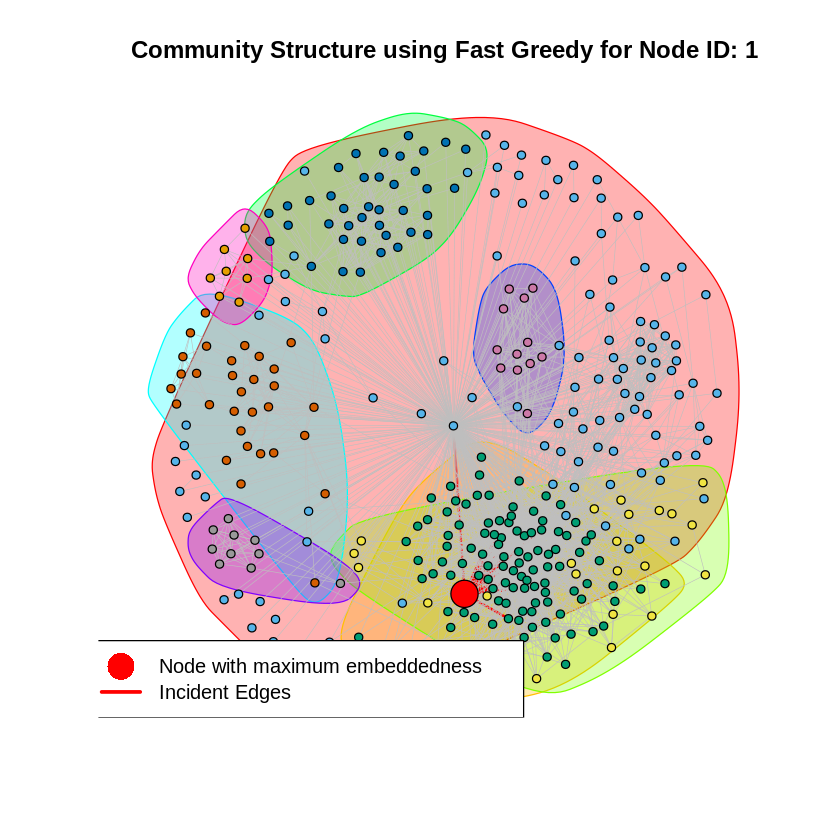

[1] "ID of node with maximum embeddedness for core node with ID 349 is: 31"


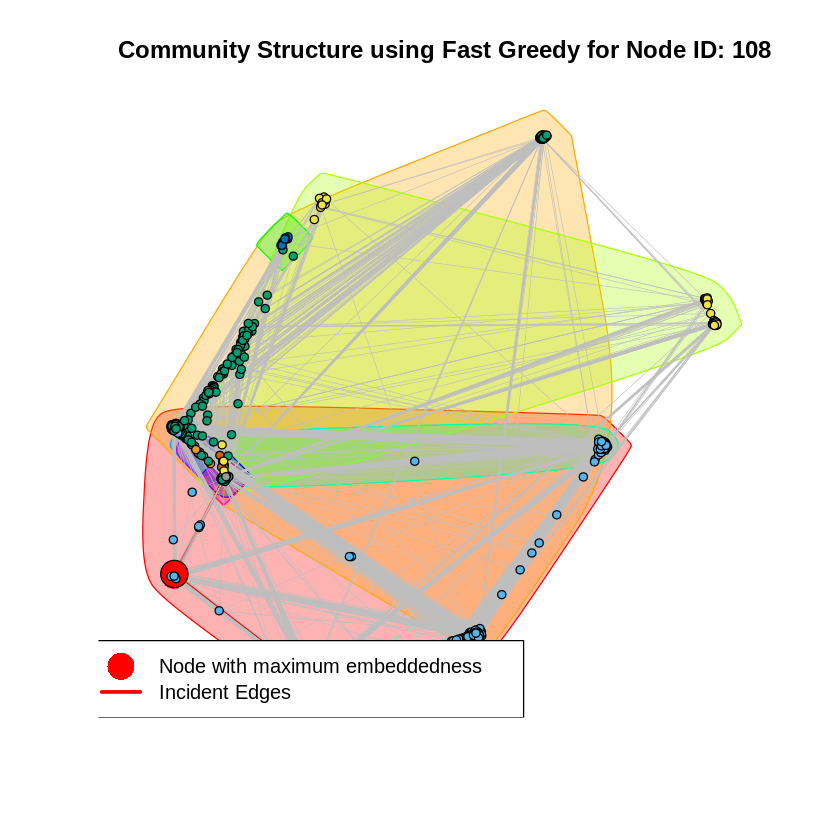

[1] "ID of node with maximum embeddedness for core node with ID 484 is: 1"


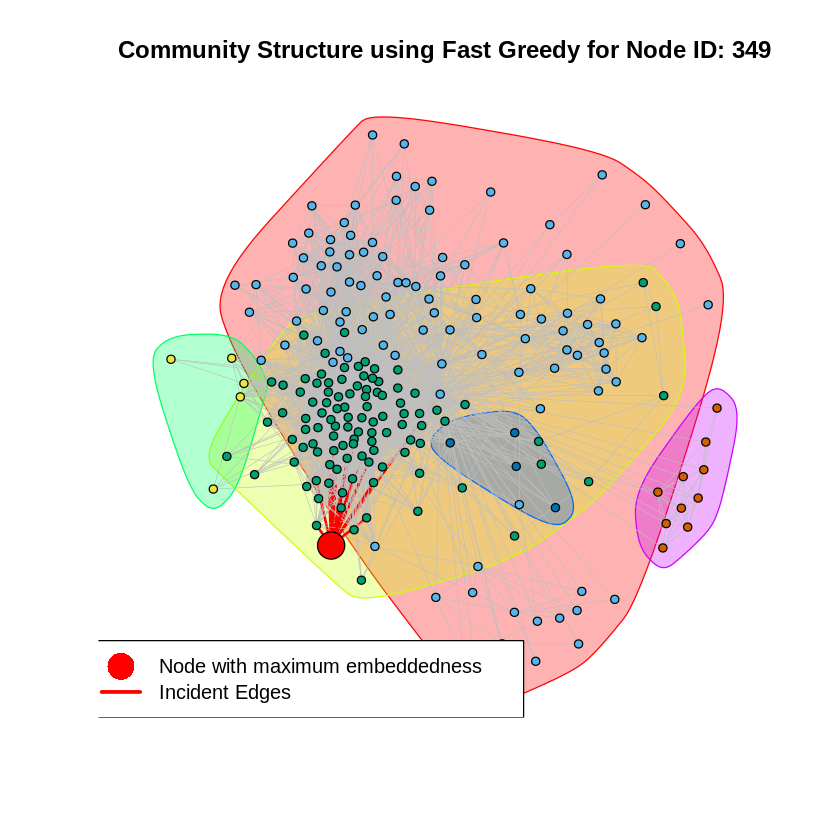

[1] "ID of node with maximum embeddedness for core node with ID 1087 is: 1"


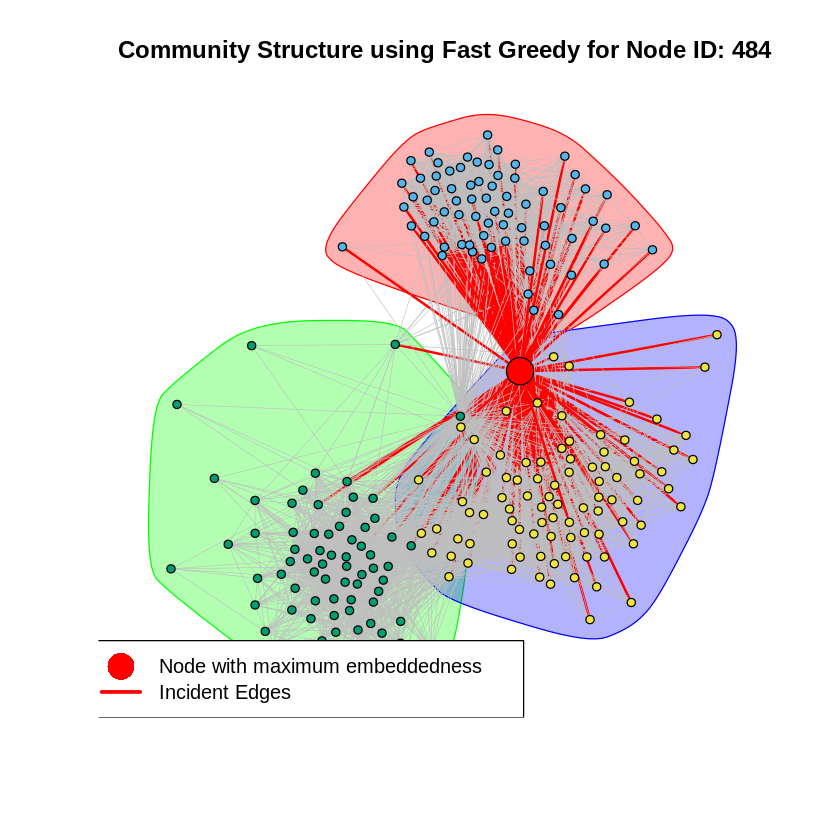

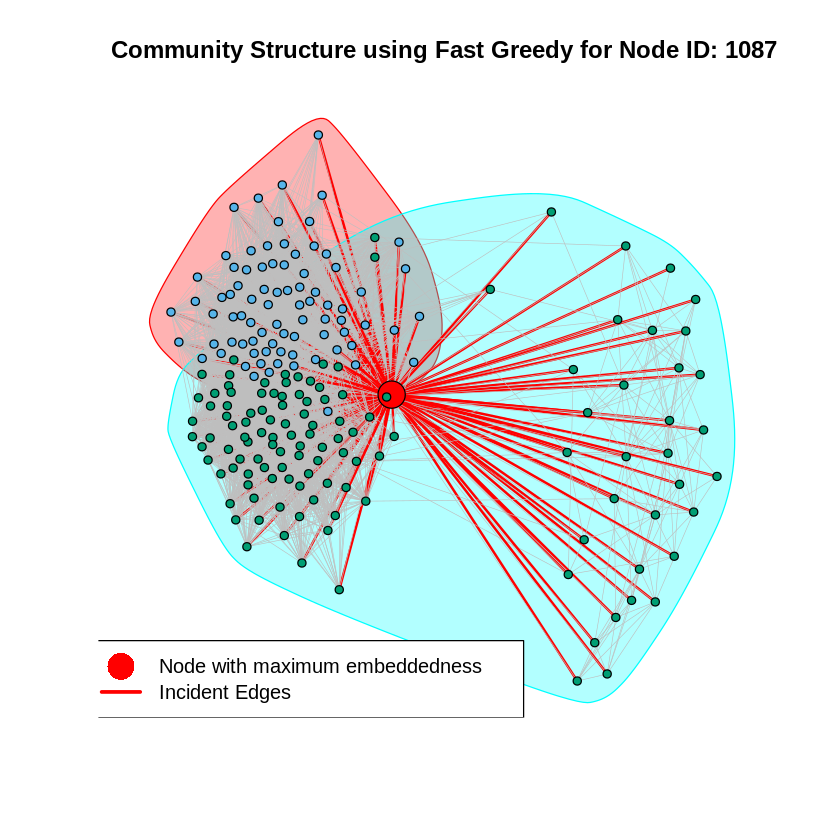

In [ ]:
# Read the data into R
data <- read.table(gzfile(destfile))

# Assuming the data contains an edge list with two columns: "from" and "to"
edges <- data.frame(from = data$V1, to = data$V2)

# Create the graph
graph <- graph.data.frame(edges, directed = FALSE)

#Looping through the node list
for(j in c(1:5)){

    nodelist = unlist(ego(graph, order=1, nodes=node_list_str[j]))
    personalized_network = induced_subgraph(graph,nodelist)
    personalized_network$name = sort(nodelist)
    embeddedness <- c()
    disp <- c()
    deg <- c()
    i=1
    for(v in vertex_attr(personalized_network)$name){
        if(v==node_list_str[j])
            next

        disp[i] = 0
        neighbor_ver = neighbors(personalized_network, node_list_str[j])
        neighbor_core = neighbors(personalized_network,v)
        inter = intersection(neighbor_ver, neighbor_core)
        embeddedness[i] = length(inter)

        deg[i] = degree(personalized_network,v)
        eg2 = delete_vertices(personalized_network, c(node_list_str[j], v))
        if(embeddedness[i]>1){
            ver = c()
            for(m in 1:length(inter)){
                ver =  c(ver,vertex_attr(personalized_network)$name[inter[m]])
            }
            ver1=c()
            for(m in 1:length(ver)){
                ver1=c(ver1,which(vertex_attr(eg2)$name==ver[m]))
            }
            disp_mat = distances(eg2,v=ver1, to=ver1)
            disp_mat[disp_mat==Inf]<-diameter(eg2)+1
            disp[i] = sum(disp_mat)
        }
        i=i+1

    }

    #Find the nodes and edges with the maximum embeddedness
    maxemb = pn$name[which(embeddedness==max(embeddedness))]
    maxnode = which(pn$name==maxemb)
    print(sprintf("ID of node with maximum embeddedness for core node with ID %d is: %d",strtoi(node_list_str[j])+1,maxnode))

    # Detect communities using the Fast-Greedy algorithm
    fc <- cluster_fast_greedy(personalized_network)
    vert_col = fc$membership+1
    vert_col[maxnode] = "red"
    vert_size = rep(3, length(vert_col))
    vert_size[maxnode] = 10
    edge_col = rep("grey", length(E(personalized_network)))
    edge_col[which(as_edgelist(personalized_network, name = FALSE)[,1] == maxnode | as_edgelist(personalized_network, name = FALSE)[,2] == maxnode)] = "red"
    edge_wid = rep(0.5,length(E(personalized_network)))
    edge_wid[which(as_edgelist(personalized_network, name = FALSE)[,1] == maxnode |  as_edgelist(personalized_network, name = FALSE)[,2] == maxnode)] = 2;

    # Plot the personalized network with community structure
    plot(personalized_network,mark.groups = fc,vertex.size=vert_size,edge.arrow.size=.5,vertex.color=vert_col,edge.color = edge_col,edge.width=edge_wid,
         vertex.label="",main = sprintf("Community Structure using Fast Greedy for Node ID: %d", strtoi(node_list_str[j])+1))
    legend('bottomleft', legend = c("Node with maximum embeddedness", "Incident Edges"),
       lty = c(0, 1), lwd = c(5,3), pch=c(16,NA),
       col = c('red','red'), pt.cex=3)

}

Warning message:
“`graph.data.frame()` was deprecated in igraph 2.0.0.
ℹ Please use `graph_from_data_frame()` instead.”


[1] "ID of node with maximum dispersion/embededness ratio for core node with ID 1 is 21"
[1] "ID of node with maximum dispersion/embededness ratio for core node with ID 108 is 977"


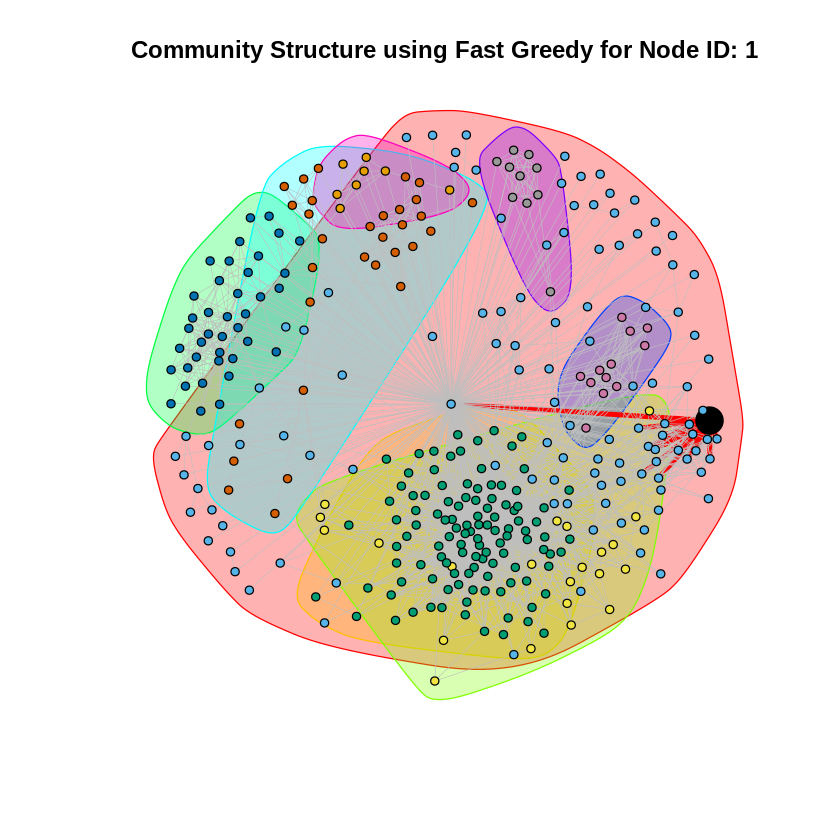

[1] "ID of node with maximum dispersion/embededness ratio for core node with ID 349 is 31"


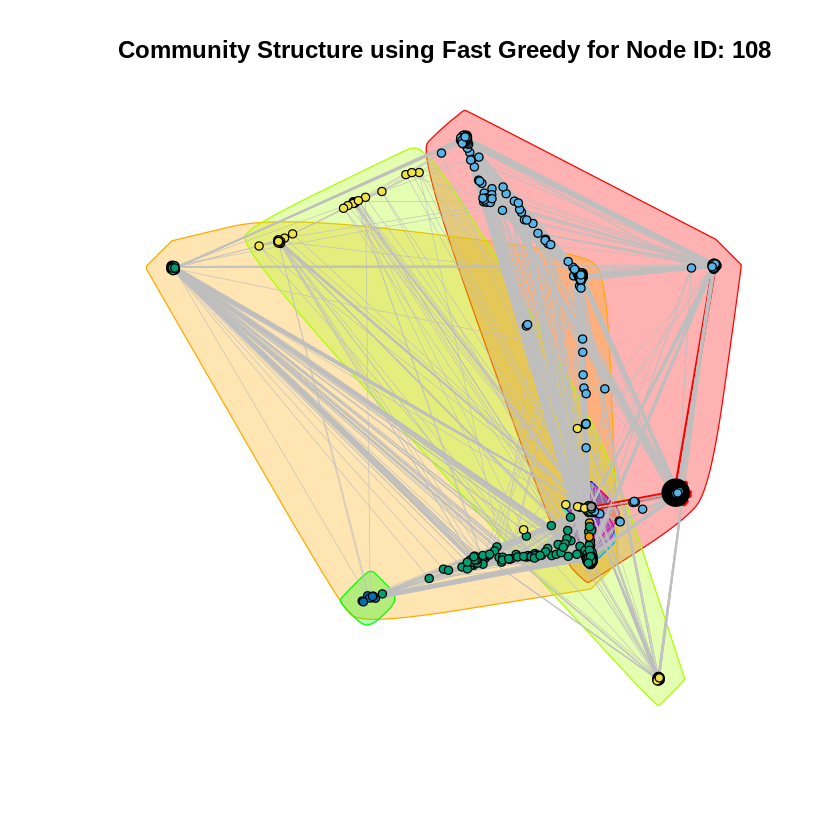

[1] "ID of node with maximum dispersion/embededness ratio for core node with ID 484 is 1"


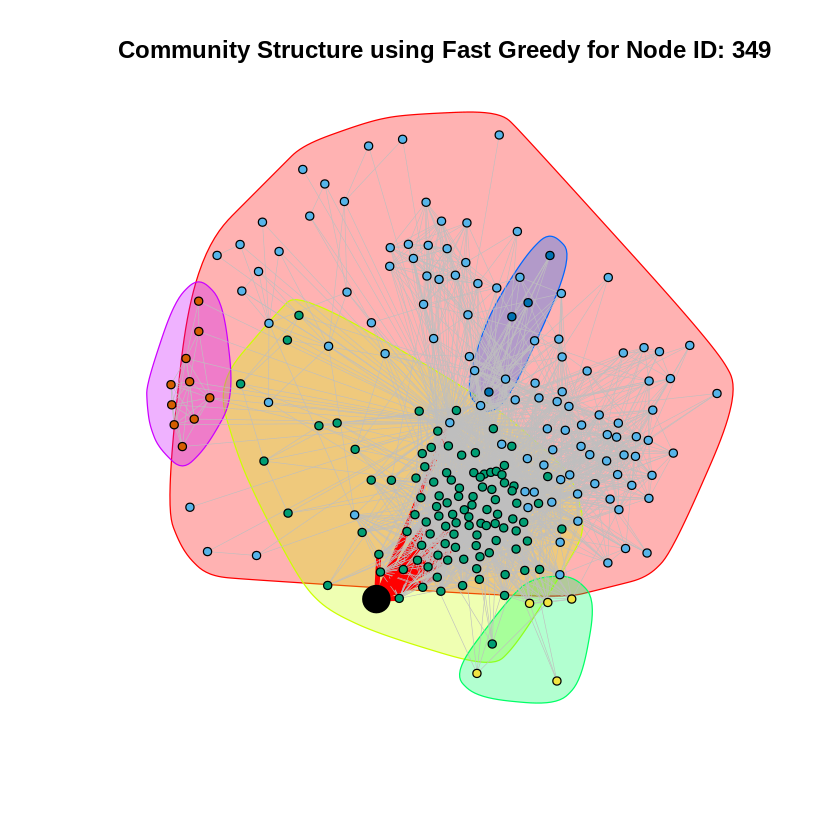

[1] "ID of node with maximum dispersion/embededness ratio for core node with ID 1087 is 1"


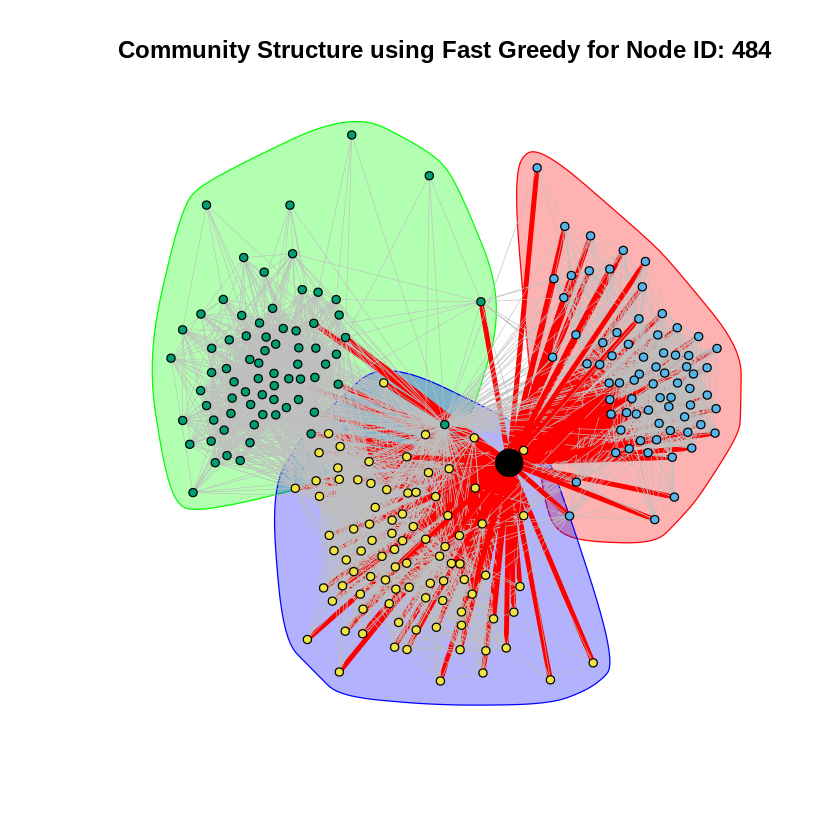

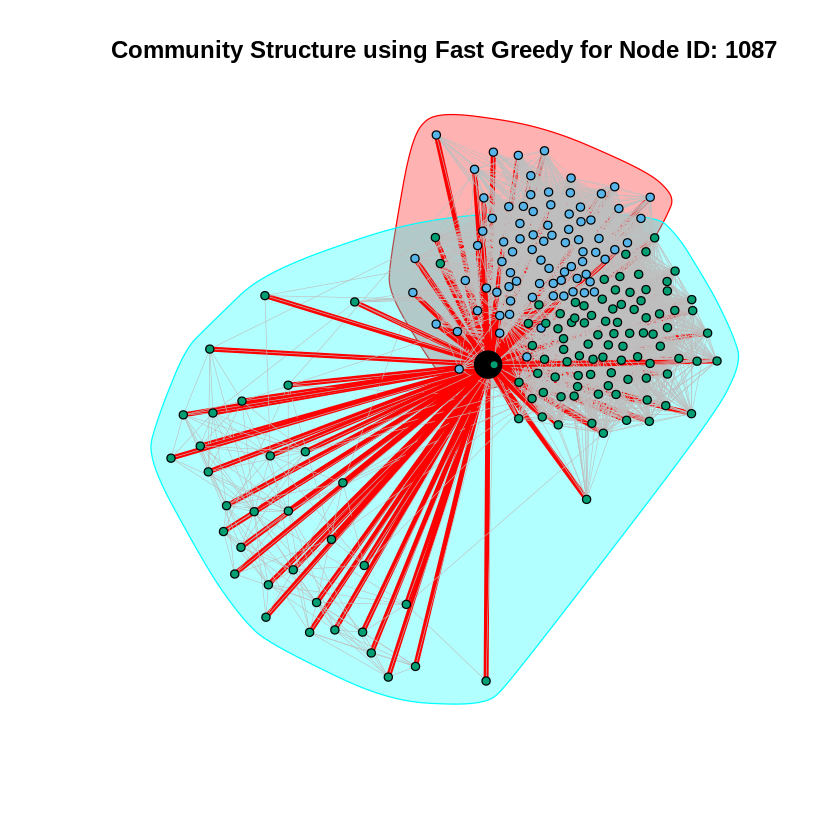

In [ ]:
# Read the data into R
data <- read.table(gzfile(destfile))

# Assuming the data contains an edge list with two columns: "from" and "to"
edges <- data.frame(from = data$V1, to = data$V2)

# Create the graph
graph <- graph.data.frame(edges, directed = FALSE)

node_list_str = c("0","107","348","483","1086")
for(j in c(1:5)){

    nodelist = unlist(ego(graph, order=1, nodes=node_list_str[j]))
    pn = induced_subgraph(graph,nodelist)
    pn$name = sort(nodelist)
    embeddedness <- c()
    disp <- c()
    deg <- c()
    i=1
    for(v in vertex_attr(pn)$name){
        if(v==node_list_str[j])
            next

        disp[i] = 0
        neh_ver = neighbors(pn, node_list_str[j])
        neh_core = neighbors(pn,v)
        inter = intersection(neh_ver, neh_core)
        embeddedness[i] = length(inter)

        deg[i] = degree(pn,v)
        eg2 = delete_vertices(pn, c(node_list_str[j], v))
        if(embeddedness[i]>1){
            ver = c()
            for(m in 1:length(inter)){
                ver =  c(ver,vertex_attr(pn)$name[inter[m]])
            }
            ver1=c()
            for(m in 1:length(ver)){
                ver1=c(ver1,which(vertex_attr(eg2)$name==ver[m]))
            }
            disp_mat = distances(eg2,v=ver1, to=ver1)
            disp_mat[disp_mat==Inf]<-diameter(eg2)+1
            disp[i] = sum(disp_mat)
        }
        i=i+1

    }

    ratio = disp/embeddedness
    ratio[mapply(is.nan,ratio)]=0
    maxratio=pn$name[which(ratio==max(ratio))]
    maxnode = which(pn$name==maxratio)
    print(sprintf("ID of node with maximum dispersion/embededness ratio for core node with ID %d is %d",strtoi(node_list_str[j])+1,maxnode))

    fc <- cluster_fast_greedy(pn)
    vert_col = fc$membership+1
    vert_col[maxnode] = "black"
    vert_size = rep(3, length(vert_col))
    vert_size[maxnode] = 10
    edge_col = rep("grey", length(E(pn)))
    edge_col[which(as_edgelist(pn, name = FALSE)[,1] == maxnode | as_edgelist(pn, name = FALSE)[,2] == maxnode)] = "red"
    edge_wid = rep(0.5,length(E(pn)))
    edge_wid[which(as_edgelist(pn, name = FALSE)[,1] == maxnode |  as_edgelist(pn, name = FALSE)[,2] == maxnode)] = 4;
    plot(pn,mark.groups = fc,vertex.size=vert_size, ,vertex.color=vert_col, edge.color = edge_col, edge.width=edge_wid,
         vertex.label="", main = sprintf("Community Structure using Fast Greedy for Node ID: %d", strtoi(node_list_str[j])+1))

}

QUESTION 14: Repeat Question 13, but now highlight the node with maximum embeddedness and the node with maximum dispersion/embeddedness (excluding the nodes having zero embeddedness if there are any). Also, highlight the edges incident to these nodes. Report the id of those nodes.

>Refer to the plots above.\
ID of node with maximum embeddedness for core node with ID 1 is: 49\
ID of node with maximum embeddedness for core node with ID 108 is: 977\
ID of node with maximum embeddedness for core node with ID 349 is: 31\
ID of node with maximum embeddedness for core node with ID 484 is: 1\
ID of node with maximum embeddedness for core node with ID 1087 is: 1

## QUESTION 15

QUESTION 15: Use the plots from Question 13 and 14 to explain the characteristics of a node revealed by each of this measure.

> We defined embeddedness of a node as the number of mutual vertices a given node shares with the core node. Embeddedness is defined as the overlap in the social circle of two users. Embeddedness depends on the number of nodes in the personalized network. The higher the number of nodes and connectivity among them in the social circle, the greater is the embeddedness. The expected value of embeddedness is dependent on the number of edges in the personalized network. In addition, large communities are likely to have a node with a large value of embeddedness. In addition, compared to dispersion, the density of incident edges from the target node is much higher. This is by definition of embeddedness, which is proportional to the degree of the node. However, this is not a good measure of the strength of ties, as users with strong relationships are likely to be associated with users from various different communities.
> We defined the dispersion of a node as the sum of distances between every pair of the mutual vertices the node shares with the core node, calculated in a modified subgraph graph with the target node and core node removed. The range (as well as expected value) of dispersions depends on the number of edges (degree) of the core node in the personalized network, the higher the number of edges, the higher is the dispersion of a target node. In addition, dispersion measures the extent to which two people’s mutual friends are not themselves well-connected, in other words, the mutual nodes of two strongly connected nodes are not well connected and must display a dispersed structure. As a result, the density of incident edges from a node with maximum dispersion will likely be lower than a node with maximum embeddedness, since the network must display a dispersed structure with connectedness among users from various different communities. Dispersion is going to be higher for those nodes whose connections are farther apart (dispersed) than the nodes with dense connectedness. As a result, dispersion is a better measure of strength of ties or relationship over embeddedness.
> The maximum value of dispersion/embeddedness (normalization of dispersion) occurs when dispersion of the node is very high while the embeddedness is very low. Such a node is likely to have mutual friends from different communities with stronger ties. The ratio is higher for smaller networks with dispersed structures, with friends that are themselves not strongly connected.


# 4. Friend recommendation in personalized networks

## QUESTION 16

In [ ]:
# Get the neighbors of node 415
neighbor_nodes <- neighbors(graph, 415)

# Combine the node IDs including node 415 itself
nodes_to_include <- c(415, neighbor_nodes)

# Create the personalized network
personalized_network <- induced_subgraph(graph, nodes_to_include)

# Get the IDs of nodes in the personalized network with degree 24
nodes_degree_24 <- which(degree(personalized_network) == 24)

# Calculate the length of the list Nr
Nr_length <- length(nodes_degree_24)

# Print the length of Nr
print(sprintf("The length of the list Nr is %d",Nr_length))

QUESTION 16: What is |Nr|, i.e. the length of the list Nr?

> The length of Nr is 11.

## QUESTION 17

In [ ]:
# Read the data into R
data <- read.table(gzfile(destfile))

# Assuming the data contains an edge list with two columns: "from" and "to"
edges <- data.frame(from = data$V1, to = data$V2)

# Create the graph
graph <- graph.data.frame(edges, directed = FALSE)

personalised_network = make_ego_graph(graph, nodes=c('414'))

Warning message:
“`graph.data.frame()` was deprecated in igraph 2.0.0.
Please use `graph_from_data_frame()` instead.”


In [ ]:
#To find the common neighbors
common.neighbors <- function(graph, i, j) {
    s_i <- neighbors(graph, i, mode = c("all"))
    s_j <- neighbors(graph, j, mode = c("all"))
    inter <- intersection(s_i, s_j)
    length(inter)
}

#Jaccard measure
jaccard <- function(graph, i, j) {
    s_i <- neighbors(graph, i, mode = c("all"))
    s_j <- neighbors(graph, j, mode = c("all"))
    inter <- intersection(s_i, s_j)
    length(inter)/(length(s_i)+length(s_j))
}

#Adamic Adar measure
adamic.adar <- function(graph, i, j) {
    s_i <- neighbors(graph, i, mode = c("all"))
    s_j <- neighbors(graph, j, mode = c("all"))
    inter <- intersection(s_i, s_j)
    sum <- 0
    for(k in inter) {
        s_k <- neighbors(graph, k, mode = c("all"))
        sum <- sum + 1/(log(length(s_k)))
    }
    sum
}

#To find who are not friends
not.friends <- function(graph, i) {
    ver <- V(graph)
    s_i <- neighbors(graph, i, mode = c("all"))
    not_friend <- ver[!ver %in% s_i]
    not_friend
}

friend_recs <- function(graph, i, neighborhood_measure, num_of_recs) {
    measure <- c()
    not_friends <- not.friends(graph, i)
    for(j in not_friends){
        if(neighborhood_measure == "common"){
            measure <- c(measure, common.neighbors(graph, i, j))
        } else if(neighborhood_measure == "jaccard") {
            measure <- c(measure, jaccard(graph, i, j))
        } else if(neighborhood_measure == "adamic") {
            measure <- c(measure, adamic.adar(graph, i, j))
        }
    }
    measure_sorted <- sort(measure, decreasing = TRUE, index.return=TRUE)
    recd_friends <- not_friends[measure_sorted$ix]
    recd_friends[c(1:num_of_recs)]
}

#To find incident edges
select.edges <- function(graph, i, p) {
    incident_edges <-incident(graph, v=i, mode = c("all"))
    sample(incident_edges, p*degree(graph,v=i))
}

#To delete certain edges from the graph
delete.edges <- function(graph, edges) {
    delete_edges(graph, edges)
}

#To add edges to the graph
add.edges <- function(graph, i, edges) {
    for(j in 1:length(edges)) {
        graph <- graph + edge(i, edges[j])
    }
    graph
}

#To find the accuracy
accuracy <- function(graph, graph3, i) {
    s_i <- neighbors(graph, i, mode = c("all"))
    s_j <- neighbors(graph3, i, mode = c("all"))
    inter <- intersection(s_i, s_j)
    length(inter)/length(s_i)
}

#To find the recommended accuracy
rec.accuracy <- function(graph, i, p, user_list, neighborhood_measure) {
    edges_to_delete <- select.edges(graph, i, p)
    graph2 <- delete.edges(graph, edges_to_delete)
    recommended <- friend_recs(graph2, i, neighborhood_measure, length(edges_to_delete))
    graph3 <- add.edges(graph2, i, recommended)
    accuracy(graph, graph3, i)
}

In [ ]:
node_ind <- c()
eg_tmp <- personalised_network[[1]]
ver_tmp <- V(eg_tmp)
for(i in 1:length(degree(eg_tmp))) {
    if(degree(eg_tmp, v=i) == 24) {
        node_ind <- c(node_ind,i)
    }
}
#Getting the user list
user_list <- ver_tmp[node_ind]
graph <- personalised_network[[1]]
p <- 0.75
neighborhood_measure <- c("common", "jaccard", "adamic")

for(measure in neighborhood_measure) {
    avg <- c()
    for(i in user_list) {
        sum <- 0
        #Looping 10 times then finding the average
        for(m in 1:10) {
            recs <- rec.accuracy(graph, i, p, user_list, measure)
            sum <- sum + recs
        }
        avg <- c(avg, sum/10)
    }
    print(sprintf("The average accuracy of the friend recommendation algorithm using %s measure is: %f",measure,mean(avg)))
}

[1] "The average accuracy of the friend recommendation algorithm using common measure is: 0.880303"
[1] "The average accuracy of the friend recommendation algorithm using jaccard measure is: 0.850000"
[1] "The average accuracy of the friend recommendation algorithm using adamic measure is: 0.879924"


QUESTION 17: Compute the average accuracy of the friend recommendation algorithm that uses:
* Common Neighbors measure
* Jaccard measure
* Adamic Adar measure

Based on the average accuracy values, which friend recommendation algorithm is the best? Hint Useful function(s): similarity

> Common neighbors is based on the assumption that if two nodes have many common neighbors, then the probability of them being connected in the future is high as well. The likelihood of future connectedness between two users is directly proportional to the number of mutual friends the users have. The score is based on the notion that people with common neighbors will be introduced to each other by that mutual friend (closing a triangle).

>Jaccard’s coefficient is used to compute similarity of sample sets in statistics. In link prediction, all the friends of a node are denoted as a set and the prediction is done by ranking the similarity of the neighbor set for each pair of nodes. It is based on the notion that two users may have many mutual friends, but not all of them are due to strong ties when compared to the overall number of neighbors of each user. The coefficient ranges from 0 to 1. It takes into account the relative number of common neighbors, adjusted for degree of nodes.

>Adamic Adar measure is based on the notion that if a mutual friend of two users has lots of friends, then it is less likely that the mutual friend will introduce the two people to each other compared to the case when the mutual friend had fewer neighbors. The more friends a node has, the lower the score, weighing neighbors with fewer friends more heavily. In other words, someone with few friends are more likely to introduce his friends to each other than someone with a lot of friends. The mutual friend of a pair of users with few neighbors contributes more to the Adamic Adar score.

>The average accuracy of the friend recommendation algorithm using common measure is: 0.880303\
The average accuracy of the friend recommendation algorithm using jaccard measure is: 0.850000\
The average accuracy of the friend recommendation algorithm using adamic measure is: 0.879924

>We see that the common neighbors algorithm performs the best, followed by Adamic Adar and Jaccard.
Note that the accuracies are very close for all three networks (within 4% of each other). In addition, Adamic
Adar and common neighbors perform very similarly, with < 1% difference in accuracy.

>Common neighbors versus Jaccard: Jaccard’s coefficient is based on the assumption that only strongly tied nodes contribute to future friend recommendation (intersection over union). In other words, if the degree of the target nodes is high, then the Jaccard’s coefficient will be low, with the implicit assumption that two users with too many friends may not have strong ties within their communities. However, if the nodes within a network are themselves not strongly tied in a network, then the Jaccard’s coefficient will perform slightly worse than just taking the intersection over mutual friends (common neighbors). This is particularly prominent in small networks, where the probability of having strong ties is lower than that of larger networks.

>Common neighbors versus Adamic Adar: Theoretically, Adamic Adar should perform better than common neighbors, as it gives more importance to nodes with few neighbors (rare neighbors), particularly the cases where . However, for such a small network, it may well be the case that the occurrence of such cases is low (explained by the low Jaccard score), and most nodes have a large number of neighbors in common. This is why common neighbors and Adamic Adar perform very similarly to each other.

>The accuracies of the algorithms are within 4% of each other. This is mainly because we are operating on a small personalized network with relatively fewer nodes and edges compared to large social networks. In addition, we are recommending friends to users with a limited degree. The reach of the network is not all-inclusive of implicit assumptions made by each of the measures and instead adhere to the most common assumptions, which does not yield significant differences in link prediction algorithm performance. In other words, we are computing local features over global similarity features, which does not truly reflect how social network friendship recommendations work on a large scale.
